In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# Any results you write to the current directory are saved as output.

/kaggle/input/yolov3/yolov3.weights
/kaggle/input/videos/solidWhiteRight.mp4
/kaggle/input/videos/solidYellowLeft.mp4
/kaggle/input/videos/challenge.mp4
/kaggle/input/images2/solidWhiteCurve.jpg
/kaggle/input/images2/solidWhiteRight.jpg
/kaggle/input/images2/solidYellowCurve2.jpg
/kaggle/input/images2/solidYellowLeft.jpg
/kaggle/input/images2/whiteCarLaneSwitch.jpg
/kaggle/input/images2/solidYellowCurve.jpg
/kaggle/input/images1/images.jpg


In [2]:
# create a YOLOv3 Keras model and save it to file
import struct
import numpy as np
from keras.layers import Conv2D
from keras.layers import Input
from keras.layers import BatchNormalization
from keras.layers import LeakyReLU
from keras.layers import ZeroPadding2D
from keras.layers import UpSampling2D
from keras.layers.merge import add, concatenate
from keras.models import Model

def _conv_block(inp, convs, skip=True):
    x = inp
    count = 0
    for conv in convs:
        if count == (len(convs) - 2) and skip:
            skip_connection = x
        count += 1
        if conv['stride'] > 1: x = ZeroPadding2D(((1,0),(1,0)))(x) # peculiar padding as darknet prefer left and top
        x = Conv2D(conv['filter'],
                    conv['kernel'],
                    strides=conv['stride'],
                    padding='valid' if conv['stride'] > 1 else 'same', # peculiar padding as darknet prefer left and top
                    name='conv_' + str(conv['layer_idx']),
                   use_bias=False if conv['bnorm'] else True)(x)
        if conv['bnorm']: x = BatchNormalization(epsilon=0.001, name='bnorm_' + str(conv['layer_idx']))(x)
        if conv['leaky']: x = LeakyReLU(alpha=0.1, name='leaky_' + str(conv['layer_idx']))(x)
    return add([skip_connection, x]) if skip else x

def make_yolov3_model():
    input_image = Input(shape=(None, None, 3))
    # Layer  0 => 4
    x = _conv_block(input_image, [{'filter': 32, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 0},
                                  {'filter': 64, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 1},
                                  {'filter': 32, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 2},
                                  {'filter': 64, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 3}])
    # Layer  5 => 8
    x = _conv_block(x, [{'filter': 128, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 5},
                        {'filter':  64, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 6},
                        {'filter': 128, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 7}])
    # Layer  9 => 11
    x = _conv_block(x, [{'filter':  64, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 9},
                        {'filter': 128, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 10}])
    # Layer 12 => 15
    x = _conv_block(x, [{'filter': 256, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 12},
                        {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 13},
                        {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 14}])
    # Layer 16 => 36
    for i in range(7):
        x = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 16+i*3},
                            {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 17+i*3}])
    skip_36 = x
    # Layer 37 => 40
    x = _conv_block(x, [{'filter': 512, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 37},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 38},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 39}])
    # Layer 41 => 61
    for i in range(7):
        x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 41+i*3},
                            {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 42+i*3}])
    skip_61 = x
    # Layer 62 => 65
    x = _conv_block(x, [{'filter': 1024, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 62},
                        {'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 63},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 64}])
    # Layer 66 => 74
    for i in range(3):
        x = _conv_block(x, [{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 66+i*3},
                            {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 67+i*3}])
    # Layer 75 => 79
    x = _conv_block(x, [{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 75},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 76},
                        {'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 77},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 78},
                        {'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 79}], skip=False)
    # Layer 80 => 82
    yolo_82 = _conv_block(x, [{'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 80},
                              {'filter':  255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 81}], skip=False)
    # Layer 83 => 86
    x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 84}], skip=False)
    x = UpSampling2D(2)(x)
    x = concatenate([x, skip_61])
    # Layer 87 => 91
    x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 87},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 88},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 89},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 90},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 91}], skip=False)
    # Layer 92 => 94
    yolo_94 = _conv_block(x, [{'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 92},
                              {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 93}], skip=False)
    # Layer 95 => 98
    x = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True,   'layer_idx': 96}], skip=False)
    x = UpSampling2D(2)(x)
    x = concatenate([x, skip_36])
    # Layer 99 => 106
    yolo_106 = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 99},
                                 {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 100},
                                 {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 101},
                                 {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 102},
                                 {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 103},
                                {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 104},
                               {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 105}], skip=False)
    model = Model(input_image, [yolo_82, yolo_94, yolo_106])
    return model

class WeightReader:
    def __init__(self, weight_file):
        with open(weight_file, 'rb') as w_f:
            major,	= struct.unpack('i', w_f.read(4))
            minor,	= struct.unpack('i', w_f.read(4))
            revision, = struct.unpack('i', w_f.read(4))
            if (major*10 + minor) >= 2 and major < 1000 and minor < 1000:
                w_f.read(8)
            else:
                w_f.read(4)
            transpose = (major > 1000) or (minor > 1000)
            binary = w_f.read()
        self.offset = 0
        self.all_weights = np.frombuffer(binary, dtype='float32')

    def read_bytes(self, size):
        self.offset = self.offset + size
        return self.all_weights[self.offset-size:self.offset]

    def load_weights(self, model):
        for i in range(106):
            try:
                conv_layer = model.get_layer('conv_' + str(i))
                print("loading weights of convolution #" + str(i))
                if i not in [81, 93, 105]:
                    norm_layer = model.get_layer('bnorm_' + str(i))
                    size = np.prod(norm_layer.get_weights()[0].shape)
                    beta  = self.read_bytes(size) # bias
                    gamma = self.read_bytes(size) # scale
                    mean  = self.read_bytes(size) # mean
                    var   = self.read_bytes(size) # variance
                    weights = norm_layer.set_weights([gamma, beta, mean, var])
                if len(conv_layer.get_weights()) > 1:
                    bias   = self.read_bytes(np.prod(conv_layer.get_weights()[1].shape))
                    kernel = self.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
                    kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
                    kernel = kernel.transpose([2,3,1,0])
                    conv_layer.set_weights([kernel, bias])
                else:
                    kernel = self.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
                    kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
                    kernel = kernel.transpose([2,3,1,0])
                    conv_layer.set_weights([kernel])
            except ValueError:
                print("no convolution #" + str(i))

    def reset(self):
        self.offset = 0

# define the model
model = make_yolov3_model()
# load the model weights
weight_reader = WeightReader('/kaggle/input/yolov3/yolov3.weights')
# set the model weights into the model
weight_reader.load_weights(model)
# save the model to file
model.save('model.h5')

Using TensorFlow backend.
/opt/conda/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/opt/conda/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/opt/conda/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/opt/conda/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

loading weights of convolution #0
loading weights of convolution #1
loading weights of convolution #2
loading weights of convolution #3
no convolution #4
loading weights of convolution #5
loading weights of convolution #6
loading weights of convolution #7
no convolution #8
loading weights of convolution #9
loading weights of convolution #10
no convolution #11
loading weights of convolution #12
loading weights of convolution #13
loading weights of convolution #14
no convolution #15
loading weights of convolution #16
loading weights of convolution #17
no convolution #18
loading weights of convolution #19
loading weights of convolution #20
no convolution #21
loading weights of convolution #22
loading weights of convolution #23
no convolution #24
loading weights of convolution #25
loading weights of convolution #26
no convolution #27
loading weights of convolution #28
loading weights of convolution #29
no convolution #30
loading weights of convolution #31
loading weights of convolution #32

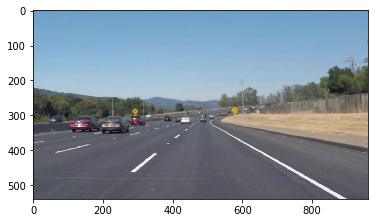

In [3]:
i1="/kaggle/input/images2/solidWhiteCurve.jpg"
import matplotlib.pyplot as plt
import matplotlib.image as mpimg# reading in an image
img = mpimg.imread(i1)# printing out some stats and plotting the imageprint('This image is:', type(image), 'with dimensions:', image.shape)
plt.imshow(img)
plt.show()

In [4]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import math
def region_of_interest(img, vertices):
    mask = np.zeros_like(img)
    match_mask_color = 255
    cv2.fillPoly(mask, vertices, match_mask_color)
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image
def draw_lines(img, lines, color=[255, 0, 0], thickness=3):
    # If there are no lines to draw, exit.
    if lines is None:
        return 
    img = np.copy(img)    # Create a blank image that matches the original in size.
    line_img = np.zeros(
        (
            img.shape[0],
            img.shape[1],
            3
        ),
        dtype=np.uint8,
    )    # Loop over all lines and draw them on the blank image.
    for line in lines:
        for x1, y1, x2, y2 in line:
            cv2.line(line_img, (x1, y1), (x2, y2), color, thickness)    # Merge the image with the lines onto the original.
    img = cv2.addWeighted(img, 0.8, line_img, 1.0, 0.0)    # Return the modified image.
    return img
def pipeline(image):
    """
    An image processing pipeline which will output
    an image with the lane lines annotated.
    """ 
    height = image.shape[0]
    width = image.shape[1]
    region_of_interest_vertices = [
        (0, height),
        (width / 2, height / 2),
        (width, height),
    ]    
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)    
    cannyed_image = cv2.Canny(gray_image, 100, 200)
 
    cropped_image = region_of_interest(
        cannyed_image,
        np.array(
            [region_of_interest_vertices],
            np.int32
        ),
    )
 
    lines = cv2.HoughLinesP(
        cropped_image,
        rho=6,
        theta=np.pi / 60,
        threshold=160,
        lines=np.array([]),
        minLineLength=40,
        maxLineGap=25
    )
 
    left_line_x = []
    left_line_y = []
    right_line_x = []
    right_line_y = []
 
    for line in lines:
        for x1, y1, x2, y2 in line:
            slope = (y2 - y1) / (x2 - x1) # <-- Calculating the slope.
            if math.fabs(slope) < 0.5: # <-- Only consider extreme slope
                continue
            if slope <= 0: # <-- If the slope is negative, left group.
                left_line_x.extend([x1, x2])
                left_line_y.extend([y1, y2])
            else: # <-- Otherwise, right group.
                right_line_x.extend([x1, x2])
                right_line_y.extend([y1, y2]) 
    min_y = int(image.shape[0] * (3 / 5)) # <-- Just below the horizon
    max_y = int(image.shape[0])
    poly_left = np.poly1d(np.polyfit(
        left_line_y,
        left_line_x,
        deg=1
    ))
 
    left_x_start = int(poly_left(max_y))
    left_x_end = int(poly_left(min_y))
 
    poly_right = np.poly1d(np.polyfit(
        right_line_y,
        right_line_x,
       deg=1
    ))
    right_x_start = int(poly_right(max_y))
    right_x_end = int(poly_right(min_y))  
    line_image = draw_lines(
        image,
        [[
            [left_x_start, max_y, left_x_end, min_y],
            [right_x_start, max_y, right_x_end, min_y],
        ]],
        thickness=5,
    )    
    return line_image

In [5]:
def compute(photo_filename,img,pipeline):
    # load and prepare image
    input_w, input_h = 416,416
    # define our new photo
    anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
    # define the probability threshold for detected objects
    class_threshold = 0.6
    # draw all results
    labels = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck",
    "boat", "traffic light", "fire hydrant", "stop sign", "parking meter", "bench",
    "bird", "cat", "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe",
    "backpack", "umbrella", "handbag", "tie", "suitcase", "frisbee", "skis", "snowboard",
    "sports ball", "kite", "baseball bat", "baseball glove", "skateboard", "surfboard",
    "tennis racket", "bottle", "wine glass", "cup", "fork", "knife", "spoon", "bowl", "banana",
    "apple", "sandwich", "orange", "broccoli", "carrot", "hot dog", "pizza", "donut", "cake",
    "chair", "sofa", "pottedplant", "bed", "diningtable", "toilet", "tvmonitor", "laptop", "mouse",
    "remote", "keyboard", "cell phone", "microwave", "oven", "toaster", "sink", "refrigerator",
    "book", "clock", "vase", "scissors", "teddy bear", "hair drier", "toothbrush"]
    # get the details of the detected objects
    if type(photo_filename)==str:
        image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
    # make prediction
    else:
        image= cv2.resize(photo_filename, (input_w, input_h))
        image_w,image_h=image.shape[1],image.shape[0]
        image=np.expand_dims(image,axis=0)
    yhat = model.predict(image)
    # summarize the shape of the list of arrays
    print([a.shape for a in yhat])
    # define the anchors
    boxes = list()
    for i in range(len(yhat)):
        # decode the output of the network
        boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
    # correct the sizes of the bounding boxes for the shape of the image
    correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
    # suppress non-maximal boxes
    do_nms(boxes, 0.5)
    # define the labels
    v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
    # summarize what we found
    for i in range(len(v_boxes)):
        print(v_labels[i], v_scores[i])
    # draw what we found
    draw_boxes(photo_filename, v_boxes, v_labels, v_scores,img,pipeline)

In [6]:
# load yolov3 model and perform object detection
import numpy as np
from numpy import expand_dims
from keras.models import load_model
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from matplotlib import pyplot
from matplotlib.patches import Rectangle

class BoundBox:
    def __init__(self, xmin, ymin, xmax, ymax, objness = None, classes = None):
        self.xmin = xmin
        self.ymin = ymin
        self.xmax = xmax
        self.ymax = ymax
        self.objness = objness
        self.classes = classes
        self.label = -1
        self.score = -1

    def get_label(self):
        if self.label == -1:
            self.label = np.argmax(self.classes)

        return self.label

    def get_score(self):
        if self.score == -1:
            self.score = self.classes[self.get_label()]

        return self.score

def _sigmoid(x):
    return 1. / (1. + np.exp(-x))

def decode_netout(netout, anchors, obj_thresh, net_h, net_w):
    grid_h, grid_w = netout.shape[:2]
    nb_box = 3
    netout = netout.reshape((grid_h, grid_w, nb_box, -1))
    nb_class = netout.shape[-1] - 5
    boxes = []
    netout[..., :2]  = _sigmoid(netout[..., :2])
    netout[..., 4:]  = _sigmoid(netout[..., 4:])
    netout[..., 5:]  = netout[..., 4][..., np.newaxis] * netout[..., 5:]
    netout[..., 5:] *= netout[..., 5:] > obj_thresh

    for i in range(grid_h*grid_w):
        row = i / grid_w
        col = i % grid_w
        for b in range(nb_box):
            # 4th element is objectness score
            objectness = netout[int(row)][int(col)][b][4]
            if(objectness.all() <= obj_thresh): continue
            # first 4 elements are x, y, w, and h
            x, y, w, h = netout[int(row)][int(col)][b][:4]
            x = (col + x) / grid_w # center position, unit: image width
            y = (row + y) / grid_h # center position, unit: image height
            w = anchors[2 * b + 0] * np.exp(w) / net_w # unit: image width
            h = anchors[2 * b + 1] * np.exp(h) / net_h # unit: image height
            # last elements are class probabilities
            classes = netout[int(row)][col][b][5:]
            box = BoundBox(x-w/2, y-h/2, x+w/2, y+h/2, objectness, classes)
            boxes.append(box)
    return boxes

def correct_yolo_boxes(boxes, image_h, image_w, net_h, net_w):
    new_w, new_h = net_w, net_h
    for i in range(len(boxes)):
        x_offset, x_scale = (net_w - new_w)/2./net_w, float(new_w)/net_w
        y_offset, y_scale = (net_h - new_h)/2./net_h, float(new_h)/net_h
        boxes[i].xmin = int((boxes[i].xmin - x_offset) / x_scale * image_w)
        boxes[i].xmax = int((boxes[i].xmax - x_offset) / x_scale * image_w)
        boxes[i].ymin = int((boxes[i].ymin - y_offset) / y_scale * image_h)
        boxes[i].ymax = int((boxes[i].ymax - y_offset) / y_scale * image_h)

def _interval_overlap(interval_a, interval_b):
    x1, x2 = interval_a
    x3, x4 = interval_b
    if x3 < x1:
        if x4 < x1:
            return 0
        else:
            return min(x2,x4) - x1
    else:
        if x2 < x3:
             return 0
        else:
            return min(x2,x4) - x3
from keras import backend as K
def bbox_iou(box1, box2):
    intersect_w = _interval_overlap([box1.xmin, box1.xmax], [box2.xmin, box2.xmax])
    intersect_h = _interval_overlap([box1.ymin, box1.ymax], [box2.ymin, box2.ymax])
    intersect = intersect_w * intersect_h
    w1, h1 = box1.xmax-box1.xmin, box1.ymax-box1.ymin
    w2, h2 = box2.xmax-box2.xmin, box2.ymax-box2.ymin
    union = w1*h1 + w2*h2 - intersect
    return float(intersect) / union

def do_nms(boxes, nms_thresh):
    if len(boxes) > 0:
        nb_class = len(boxes[0].classes)
    else:
        return
    for c in range(nb_class):
        sorted_indices = np.argsort([-box.classes[c] for box in boxes])
        for i in range(len(sorted_indices)):
            index_i = sorted_indices[i]
            if boxes[index_i].classes[c] == 0: continue
            for j in range(i+1, len(sorted_indices)):
                index_j = sorted_indices[j]
                if bbox_iou(boxes[index_i], boxes[index_j]) >= nms_thresh:
                    boxes[index_j].classes[c] = 0

# load and prepare an image
def load_image_pixels(filename, shape):
    # load the image to get its shape
    image = load_img(filename)
    width, height = image.size
    # load the image with the required size
    image = load_img(filename, target_size=shape)
    # convert to numpy array
    image = img_to_array(image)
    # scale pixel values to [0, 1]
    image = image.astype('float32')
    image /= 255.0
    # add a dimension so that we have one sample
    image = expand_dims(image, 0)
    return image, width, height

# get all of the results above a threshold
def get_boxes(boxes, labels, thresh):
    v_boxes, v_labels, v_scores = list(), list(), list()
    # enumerate all boxes
    for box in boxes:
        # enumerate all possible labels
        for i in range(len(labels)):
            # check if the threshold for this label is high enough
            if box.classes[i] > thresh:
                v_boxes.append(box)
                v_labels.append(labels[i])
                v_scores.append(box.classes[i]*100)
                # don't break, many labels may trigger for one box
    return v_boxes, v_labels, v_scores
def draw_boxes(filename, v_boxes, v_labels, v_scores,pshow,pipeline):
    q=pipeline(pshow)
    pyplot.imshow(q)
    # get the context for drawing boxes
    ax = pyplot.gca()
    # plot each box
    for i in range(len(v_boxes)):
        box = v_boxes[i]
        # get coordinates
        y1, x1, y2, x2 = box.ymin, box.xmin, box.ymax, box.xmax
        # calculate width and height of the box
        width, height = x2 - x1, y2 - y1
        # create the shape
        rect = Rectangle((x1, y1), width, height, fill=False, color='white')
        # draw the box
        ax.add_patch(rect)
        # draw text and score in top left corner
        label = "%s" % (v_labels[i])
        pyplot.text(x1, y1, label, color='white')
    # show the plot
    return pyplot.show()
# load yolov3 model
model = load_model('model.h5')
# define the expected input shape for the model

/opt/conda/lib/python3.6/site-packages/keras/engine/saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


Sun Aug 25 16:33:15 2019
<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.28053379058838
truck 94.82464790344238
car 86.17922067642212
car 95.62216401100159
car 73.82465600967407


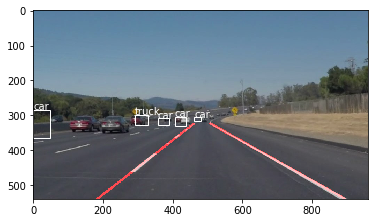

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.72049760818481
truck 89.19841051101685
car 86.78051233291626
car 96.28889560699463
car 65.4617965221405


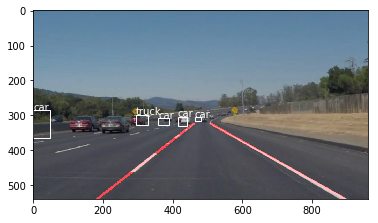

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 88.32243084907532
truck 91.95681810379028
car 86.10697984695435
car 95.02096176147461
car 65.24639129638672


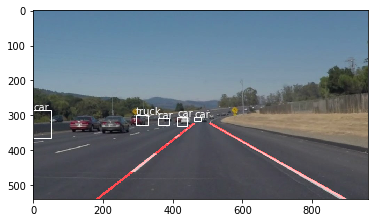

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 88.27385306358337
truck 89.25461173057556
car 86.94748878479004
car 95.19882202148438
car 76.64188742637634


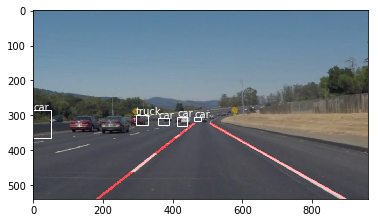

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.38252139091492
truck 89.79887366294861
car 86.98242902755737
car 95.55633664131165
car 74.4353175163269


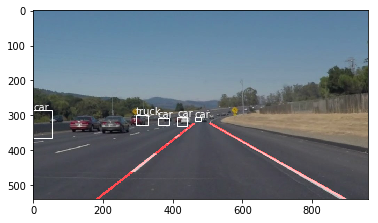

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.42733716964722
truck 91.71115159988403
car 60.271155834198
car 86.24328374862671
car 95.80351114273071
car 78.89279127120972


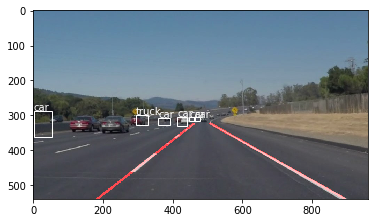

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.92788815498352
truck 92.3650860786438
car 60.48126816749573
car 83.36883187294006
car 96.4962899684906
car 72.06473350524902


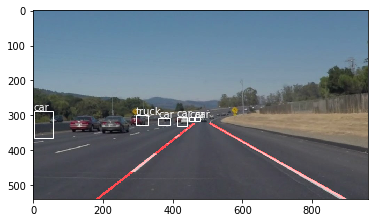

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.98325490951538
truck 92.83977150917053
car 65.6241238117218
car 83.40213894844055
car 95.9295928478241
car 64.0814483165741


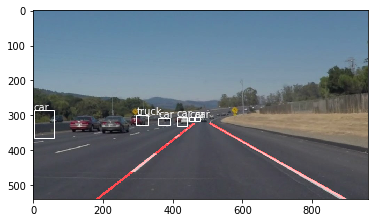

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.88420391082764
truck 93.90286207199097
car 83.7328553199768
car 96.10270261764526
car 78.011554479599


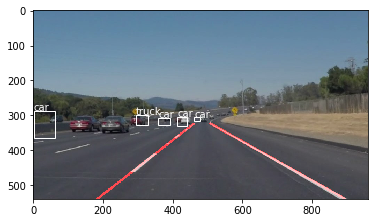

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.36618876457214
truck 89.68293070793152
car 88.21696639060974
car 97.1222460269928
car 67.63660907745361


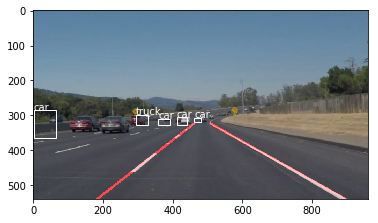

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.68345332145691
car 62.90408372879028
car 76.66130065917969
truck 90.69629311561584
car 96.06908559799194
car 85.21150946617126


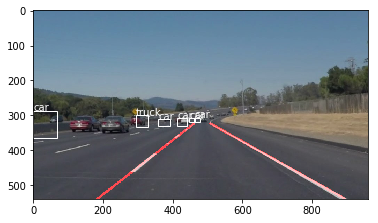

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 87.74400353431702
car 74.54992532730103
truck 83.39722752571106
car 96.42120003700256
car 88.5452151298523


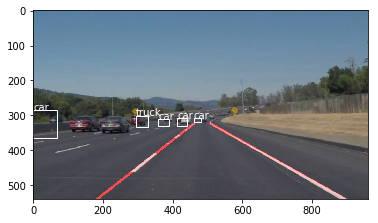

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.75974631309509
car 68.352210521698
car 80.70717453956604
truck 87.22953200340271
car 96.19917869567871
car 83.62927436828613


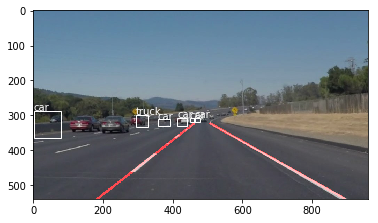

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.14447236061096
truck 91.44885540008545
car 88.46912384033203
car 96.74471020698547
car 71.19365334510803


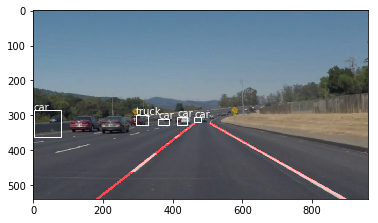

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.31335020065308
truck 87.04701662063599
car 62.71656155586243
car 77.0332396030426
car 78.04981470108032
car 95.59602737426758


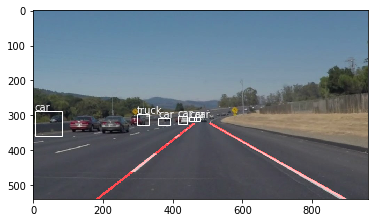

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.44951891899109
car 65.45103192329407
truck 75.24623274803162
car 73.10230135917664
car 60.40450930595398
car 79.6987235546112
car 88.3948266506195


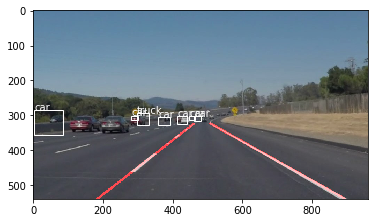

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.4553165435791
car 75.55596828460693
truck 71.22425436973572
car 63.81070613861084
car 72.76386022567749
car 81.92133903503418


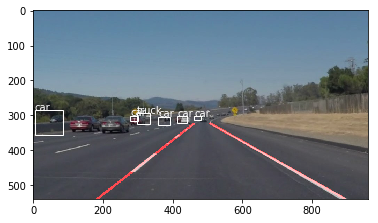

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.37414884567261
car 80.08431792259216
truck 62.593334913253784
car 79.16175723075867
car 61.96485757827759
car 81.91856145858765
car 91.07311964035034


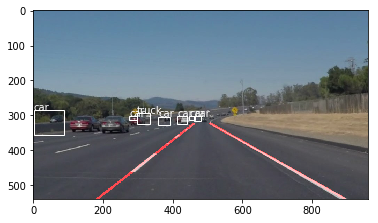

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.3552474975586
car 71.81219458580017
truck 82.56989121437073
car 76.69896483421326
car 70.81824541091919
car 84.00559425354004
car 95.23441195487976


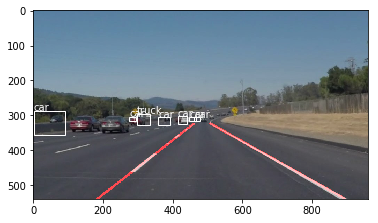

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.72736811637878
car 73.65352511405945
truck 87.24382519721985
car 84.53657627105713
car 96.83523178100586
car 80.24014830589294


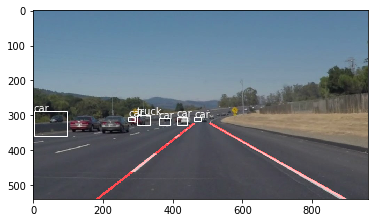

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 85.68029999732971
car 62.95127272605896
truck 84.02363061904907
car 79.05977368354797
car 67.1992540359497
car 97.4320650100708
car 72.1998929977417


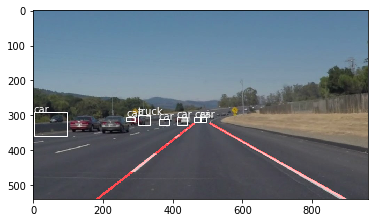

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.50203275680542
truck 84.11377668380737
car 76.68007016181946
car 72.47172594070435
car 97.52746224403381
car 71.00714445114136


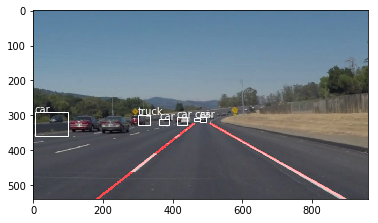

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.09020137786865
car 65.9562349319458
truck 71.59143090248108
car 79.47852611541748
car 66.91710352897644
car 97.45539426803589
car 71.1627721786499


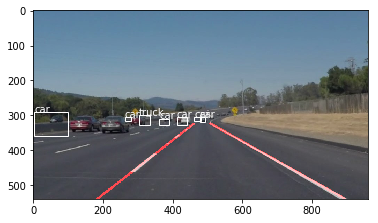

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 84.90926623344421
truck 78.4491240978241
car 81.06447458267212
car 63.71726393699646
car 96.81236147880554
car 82.62906074523926


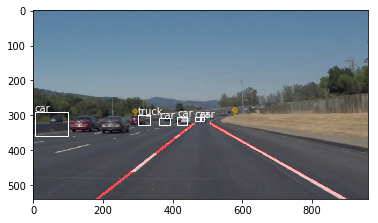

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 81.26828670501709
car 69.99478936195374
truck 80.39456009864807
car 81.37657046318054
car 67.43764281272888
car 97.08749651908875
car 88.69077563285828


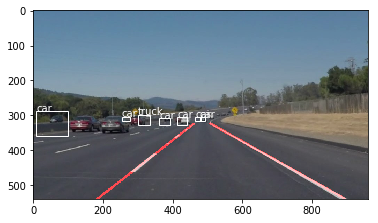

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 78.8717269897461
car 70.69540023803711
truck 69.89082098007202
car 82.75752663612366
car 72.83903360366821
car 96.44045233726501
car 87.95831799507141


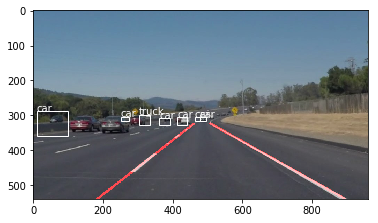

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 81.58578872680664
truck 60.846590995788574
car 78.85924577713013
car 73.87254238128662
car 96.70560956001282
car 86.5772008895874


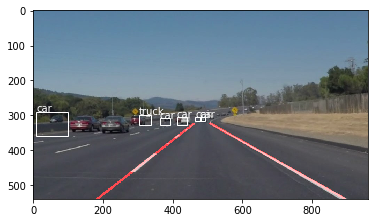

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 83.2084596157074
car 63.81716728210449
truck 62.33751177787781
car 81.62257075309753
car 73.1076717376709
car 95.73981165885925
car 88.25960755348206


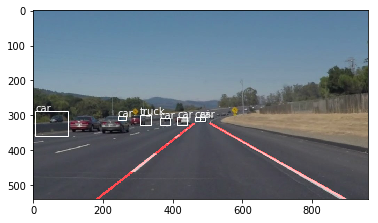

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 84.3964159488678
car 60.02880930900574
truck 63.93188238143921
car 83.47187638282776
car 71.12084031105042
car 96.08726501464844
car 85.98110675811768


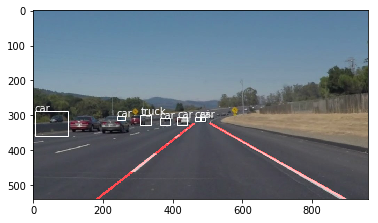

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 85.15127897262573
truck 62.57961392402649
car 61.74525022506714
car 68.55377554893494
car 76.49598121643066
car 93.44173073768616
car 85.81223487854004


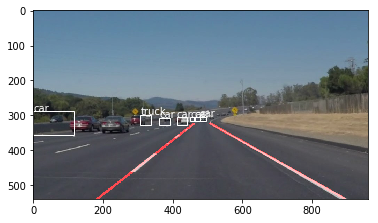

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 82.10211992263794
truck 73.94121289253235
car 61.36191487312317
car 78.35826277732849
car 96.37907147407532
car 83.48727226257324


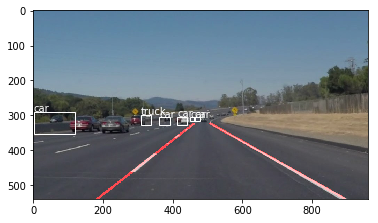

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 82.60318636894226
truck 77.85395383834839
car 83.54242444038391
car 61.54460906982422
car 69.94091272354126
car 95.05583643913269


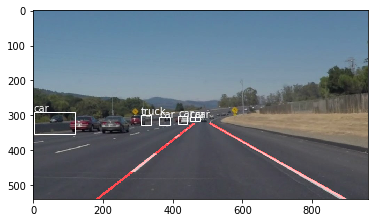

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 84.07670855522156
car 74.56052899360657
truck 75.75942873954773
car 86.44695281982422
car 65.88231325149536
car 73.21923971176147
car 93.4589684009552


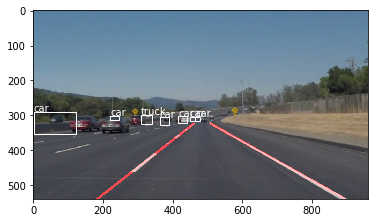

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.7391607761383
car 88.82557153701782
truck 78.43300700187683
car 82.88126587867737
car 70.92163562774658
car 73.39147329330444
car 96.72375321388245


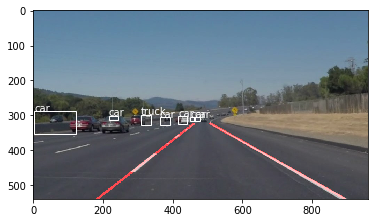

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 81.76197409629822
truck 62.11155652999878
car 70.71818113327026
car 69.74444389343262
car 96.72681093215942
car 88.60146403312683


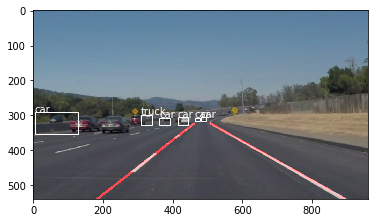

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.12809991836548
car 81.05353116989136
car 96.81919813156128
car 85.77359318733215


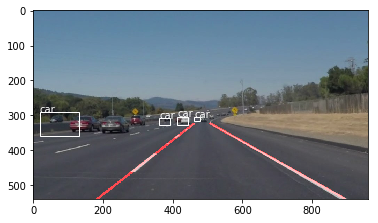

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.05489563941956
car 82.72958993911743
car 60.93623638153076
car 96.20234966278076
car 82.93255567550659


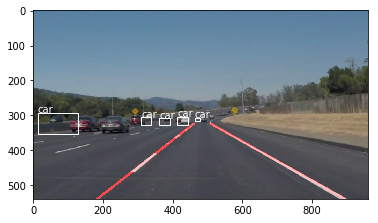

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.98156213760376
truck 66.03253483772278
car 80.47510385513306
car 67.30302572250366
car 96.05668187141418
car 84.01238918304443


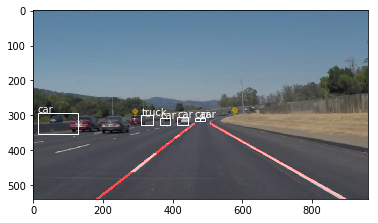

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 87.37930059432983
truck 70.25834918022156
car 77.45584845542908
car 96.55861854553223
car 88.23604583740234


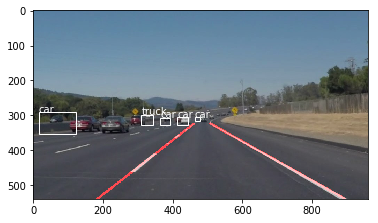

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 83.91532301902771
car 79.8502266407013
car 60.66181659698486
car 79.34304475784302
car 95.60390114784241
car 82.26446509361267


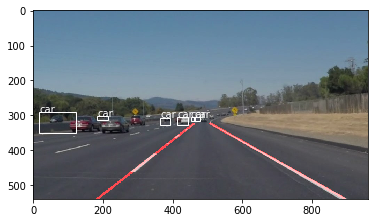

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 82.01656341552734
car 70.13502717018127
truck 64.65542912483215
car 86.0872745513916
car 67.44990348815918
car 80.70109486579895
car 95.55684328079224


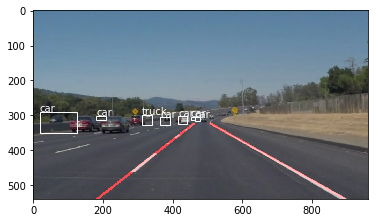

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 71.45881056785583
truck 61.79278492927551
car 89.35258984565735
car 68.4226930141449
car 80.91399669647217
car 70.61512470245361
car 93.89801621437073


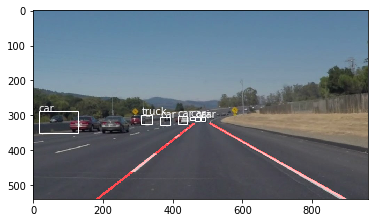

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 86.0115110874176
truck 68.83241534233093
car 89.93833661079407
car 63.32664489746094
car 82.75707364082336
car 64.96297121047974
car 90.3285801410675


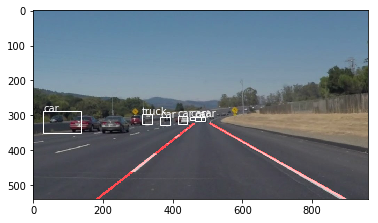

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 87.65981793403625
truck 66.30021929740906
car 89.40563797950745
car 63.01823854446411
car 86.20855808258057
car 70.49516439437866
car 88.36469054222107


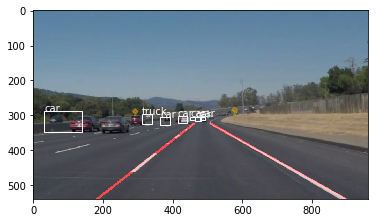

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 83.06353092193604
car 69.76808905601501
truck 70.18411159515381
car 90.76635241508484
car 88.81418704986572
car 89.8404061794281


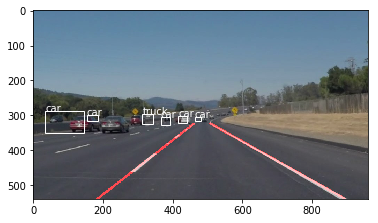

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 77.08067297935486
car 69.8887825012207
truck 78.90462875366211
car 88.45173120498657
car 64.91889357566833
car 89.35136795043945
car 63.116079568862915
car 90.95368385314941


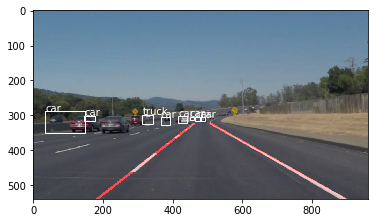

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 71.88822627067566
truck 65.29898047447205
car 90.01673460006714
car 87.38309741020203
car 67.42701530456543
car 89.57238793373108


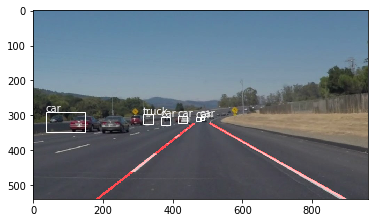

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 73.69320392608643
truck 62.98723220825195
car 84.66176390647888
car 68.46554279327393
car 87.07609176635742
car 64.94126319885254
car 90.49134254455566


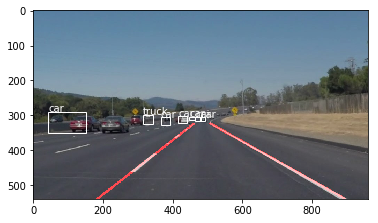

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.50376057624817
truck 68.85367035865784
car 80.9704840183258
car 68.55119466781616
car 89.44099545478821
car 93.43212842941284


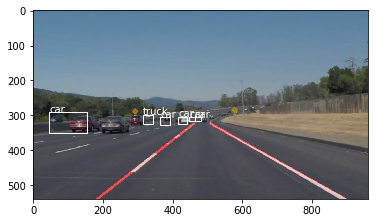

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.22965836524963
car 66.03765487670898
car 89.34893608093262
car 93.52267980575562
car 84.15243625640869


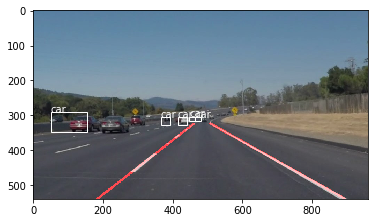

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.24514865875244
car 71.37068510055542
car 89.70993757247925
car 91.82230234146118
car 84.65412259101868


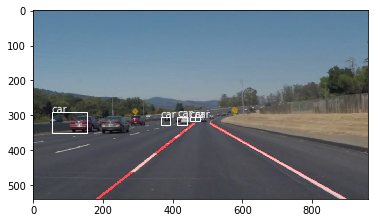

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.19617748260498
truck 68.2238519191742
car 84.03341174125671
car 64.4950807094574
car 89.3092155456543
car 91.30502939224243


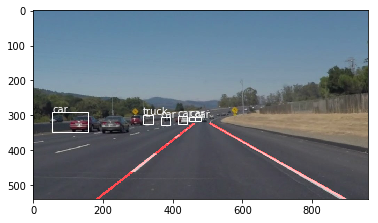

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.17693996429443
car 71.19897603988647
car 90.74809551239014
car 91.6355848312378
car 81.88477754592896


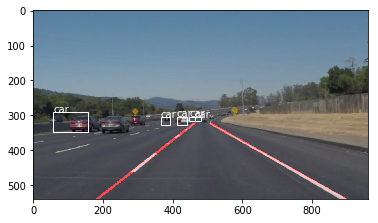

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.71107912063599
car 73.09381365776062
car 82.74013996124268
car 92.4340009689331
car 74.38309788703918


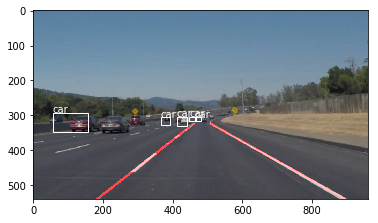

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.46820402145386
car 74.29916858673096
car 86.1024796962738
car 89.62772488594055


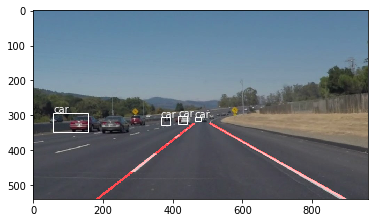

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 86.4775538444519
car 90.88470935821533
car 92.81622767448425
car 81.86097741127014


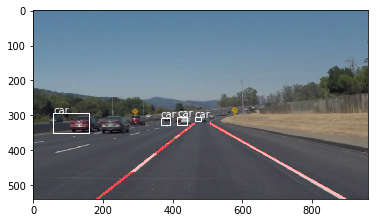

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 85.38787961006165
car 66.70315265655518
car 91.941899061203
car 92.81614422798157
car 74.35240149497986


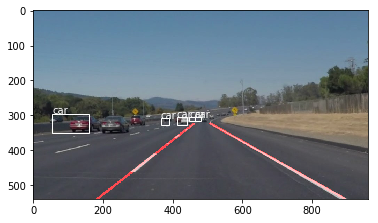

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 81.39635920524597
car 65.26677012443542
car 86.10290288925171
car 93.94770860671997
car 62.62386441230774


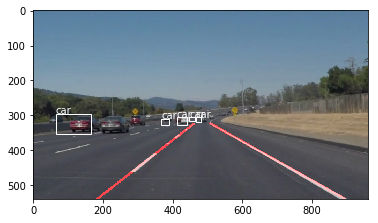

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.61553883552551
car 68.17272305488586
car 86.9830310344696
car 91.89432263374329
car 61.46462559700012


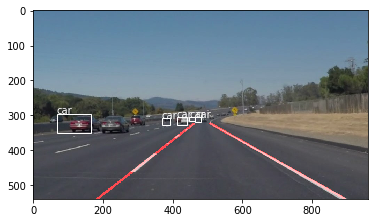

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.65575098991394
car 64.98038172721863
car 89.0247106552124
car 93.2804524898529
car 71.37729525566101


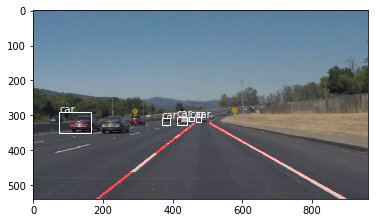

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 85.18430590629578
car 66.34332537651062
car 88.82723450660706
car 97.50726222991943
car 70.08630633354187


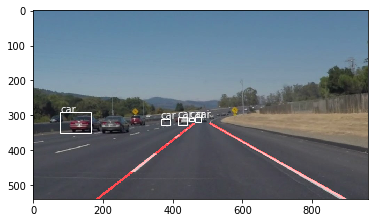

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 79.70463633537292
car 70.95355987548828
car 87.80361413955688
car 96.8612790107727
car 73.5566258430481


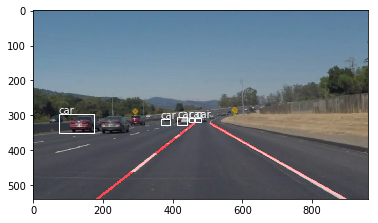

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 87.38630414009094
car 71.25065922737122
car 85.59295535087585
car 96.21597528457642
car 66.51526093482971


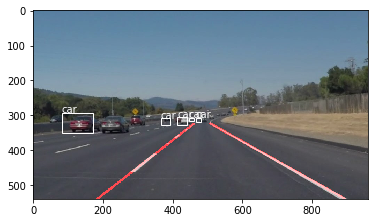

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.02617120742798
car 74.14316534996033
car 83.58131647109985
car 95.94840407371521
car 69.41901445388794


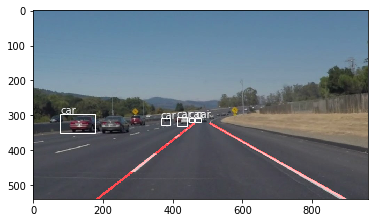

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.8661139011383
car 71.44507169723511
car 84.19992327690125
car 94.46291923522949
car 67.02978014945984


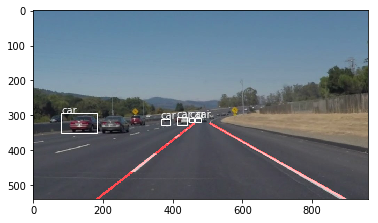

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.39446830749512
truck 70.23950219154358
car 72.19499945640564
car 83.41215252876282
car 94.6482241153717
car 72.51449823379517


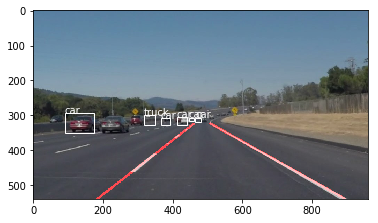

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.60054230690002
truck 78.98139953613281
car 66.07482433319092
car 86.78367733955383
car 94.87326145172119
car 75.40873289108276


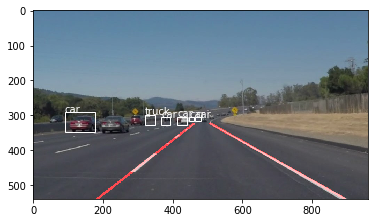

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.34546136856079
truck 69.38402056694031
car 73.31757545471191
car 69.70755457878113
car 84.75474715232849
car 95.35928964614868


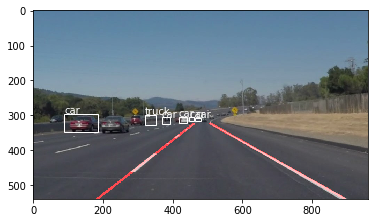

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.69963598251343
truck 72.26086854934692
car 71.94561958312988
car 86.54137849807739
car 94.17746663093567
car 80.82361221313477


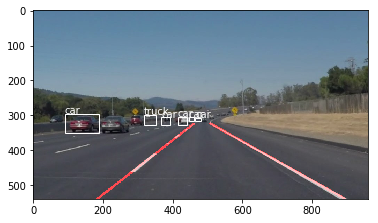

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 87.76412010192871
truck 73.15958738327026
car 71.44914269447327
car 84.27280783653259
car 93.01444888114929
car 82.55246877670288


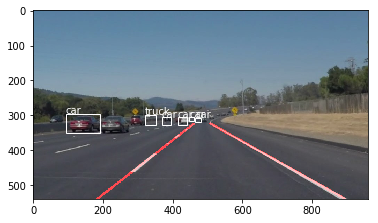

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 88.78124952316284
truck 73.35985898971558
car 65.04800915718079
car 85.08896231651306
car 94.08850073814392
car 81.66757822036743


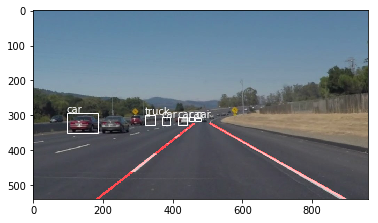

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.23366665840149
truck 63.36730718612671
car 84.22362804412842
car 93.67576241493225
car 73.57574105262756


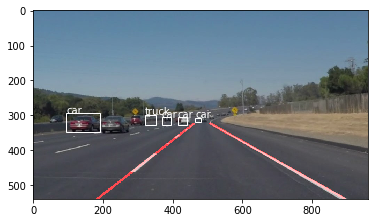

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 85.68690419197083
car 62.14370131492615
car 83.27063322067261
car 91.87093377113342
car 70.86000442504883


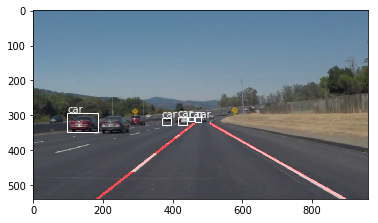

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 85.37587523460388
truck 66.33737683296204
car 63.151878118515015
car 80.17479181289673
car 92.28801131248474
car 71.18679285049438


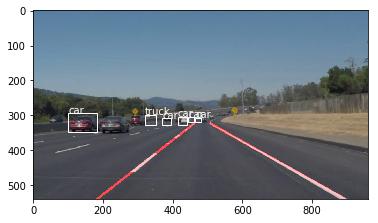

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 87.48653531074524
truck 66.77858829498291
car 82.23738670349121
car 92.28336811065674
car 64.91276025772095


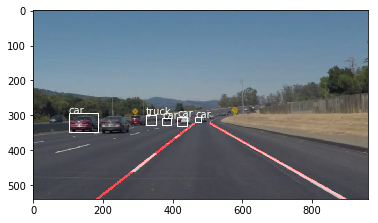

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 84.02298092842102
truck 61.57051920890808
car 67.73038506507874
car 86.78790330886841
car 91.1421537399292
car 61.25946640968323


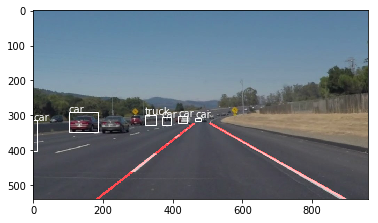

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 78.16786170005798
car 60.29515266418457
truck 60.276949405670166
car 76.31417512893677
car 86.08195781707764
car 88.90305757522583
car 67.30989813804626


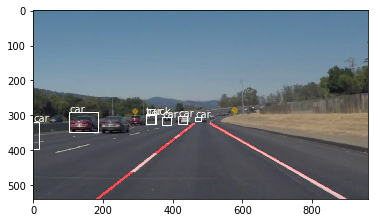

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.38745498657227
car 68.90272498130798
car 87.0779037475586
car 88.16941976547241
car 82.71921277046204


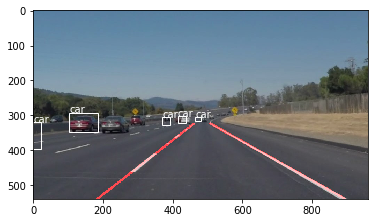

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 69.91391777992249
truck 68.63754987716675
car 63.38393688201904
car 83.9551568031311
car 88.85548710823059
car 60.39031147956848
car 85.00205278396606


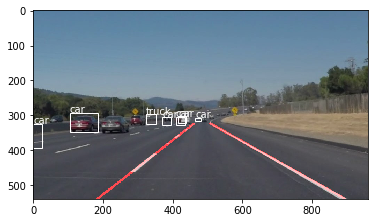

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
truck 66.26874804496765
car 63.93386125564575
car 87.76851892471313
car 85.11947393417358
car 90.53488969802856
car 60.56581735610962
car 83.45333933830261


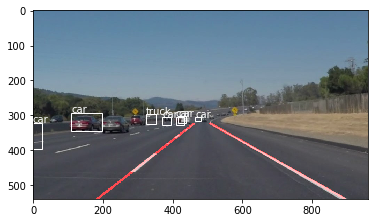

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 83.14511179924011
car 64.04401063919067
car 63.24170231819153
car 89.05813694000244
car 89.79611396789551
car 90.62261581420898
car 60.26262044906616


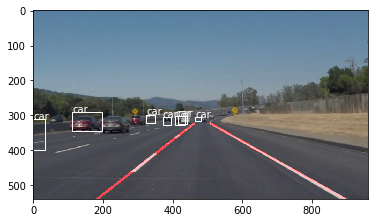

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.63544964790344
car 94.39740777015686
car 69.50582265853882
car 87.47241497039795
car 89.275723695755


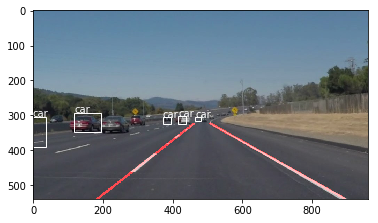

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.7853832244873
car 91.8178915977478
car 61.761754751205444
car 66.41256213188171
car 64.8366928100586
car 86.71112656593323
car 88.65207433700562


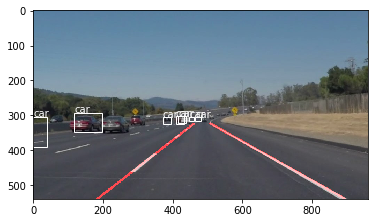

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.17603802680969
car 94.97407674789429
car 71.15088105201721
car 84.65197682380676
car 63.16384673118591
car 86.28076910972595


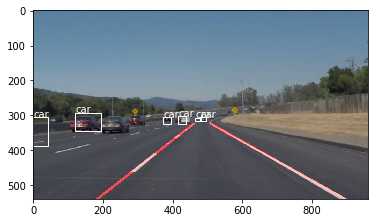

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.91808891296387
car 96.82183265686035
car 65.751051902771
car 82.63158798217773
car 70.42022943496704
car 85.81250309944153


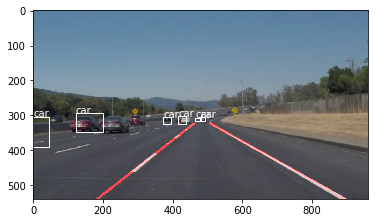

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.78788685798645
car 67.49812960624695
car 68.26385855674744
car 79.84837293624878
car 76.67314410209656
car 88.40817213058472
car 77.73663401603699


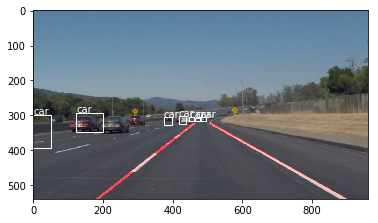

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 87.91230916976929
car 98.07698130607605
car 66.98866486549377
car 66.3855254650116
car 79.16802167892456
car 77.20234394073486
car 70.49619555473328


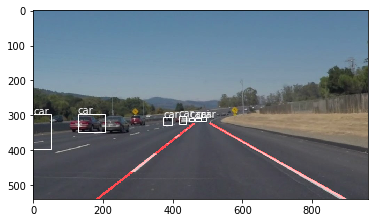

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 83.29114317893982
car 98.65135550498962
car 75.98210573196411
car 80.05085587501526
car 69.48603391647339
car 71.60739302635193
car 75.52731037139893


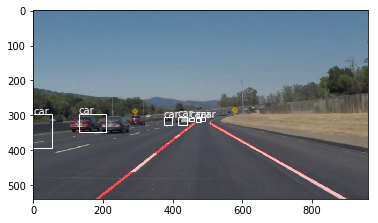

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 84.63010787963867
car 98.85652661323547
car 71.88585996627808
car 77.07676887512207
car 81.15465044975281
car 68.26931834220886
car 84.04247164726257


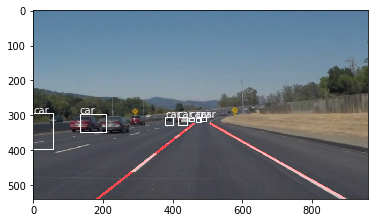

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 86.81530356407166
car 98.86001944541931
car 68.79379749298096
car 73.57122302055359
car 78.91462445259094
car 67.94655919075012
car 78.3873438835144


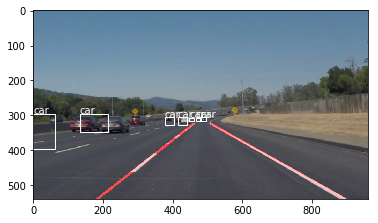

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 86.11478805541992
car 98.74523878097534
car 66.05576276779175
car 76.48338079452515
car 86.46162748336792
car 60.18344759941101
car 89.02932405471802
car 87.93739676475525


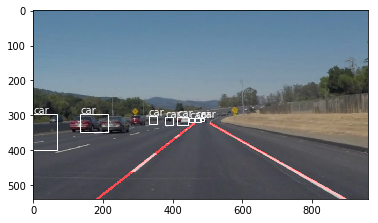

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.0317165851593
car 70.55593729019165
car 79.04029488563538
car 86.74050569534302
car 91.01158380508423
car 89.12172317504883
car 89.48855400085449


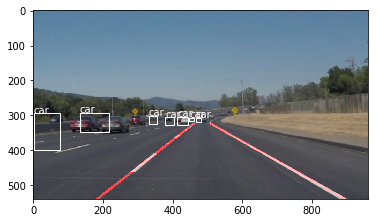

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.83219003677368
car 72.86152243614197
car 75.99278092384338
car 83.35023522377014
car 60.32434105873108
car 86.26368045806885
car 86.72245740890503
car 88.55705857276917


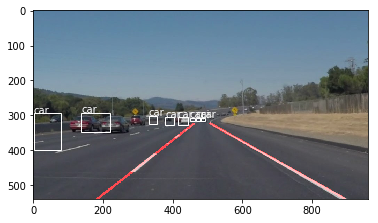

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.1540789604187
car 75.99000334739685
car 84.79057550430298
car 78.18448543548584
car 66.18137955665588
car 92.48061776161194
car 84.68398451805115
car 88.85380029678345


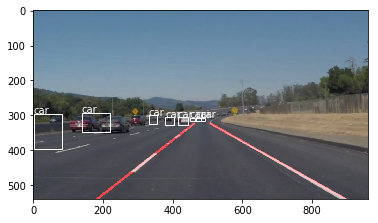

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 82.90009498596191
car 99.16957020759583
car 70.30017971992493
car 63.938140869140625
car 72.45175838470459
car 79.2252242565155
car 68.2948648929596
car 85.41357517242432
car 80.8380663394928


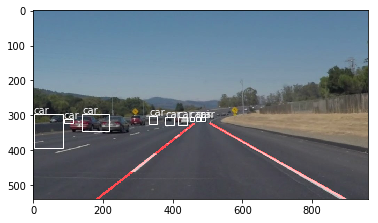

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.98054599761963
car 87.05679178237915
car 72.68902063369751
car 69.05022859573364
car 63.207316398620605
car 86.93200945854187
car 82.85211324691772


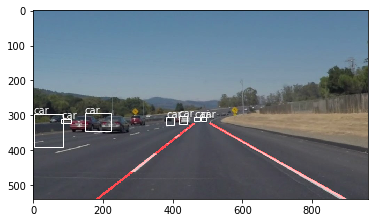

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.12269711494446
car 62.39369511604309
car 84.99382138252258
car 62.940168380737305
car 66.77800416946411
car 71.02271914482117
car 64.54294919967651
car 90.58941006660461
car 81.3838005065918


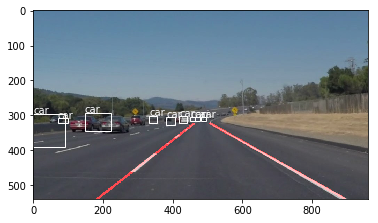

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.27827286720276
car 99.30270314216614
car 61.900508403778076
car 86.21349930763245
car 69.14364099502563
car 68.13705563545227
car 79.7633707523346


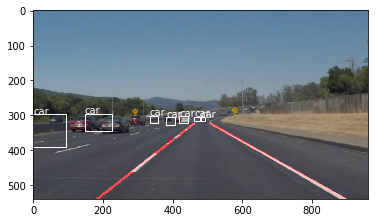

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.06309843063354
car 73.59781265258789
car 78.22115421295166
car 87.25537061691284
car 61.24540567398071
car 62.26999759674072
car 88.69348764419556


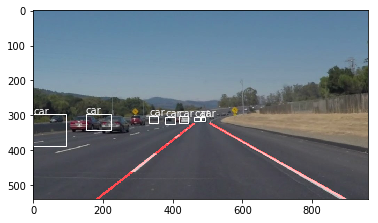

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.61302876472473
car 73.23405146598816
car 87.16248869895935
car 87.8355085849762
car 75.42201280593872
car 90.76541066169739


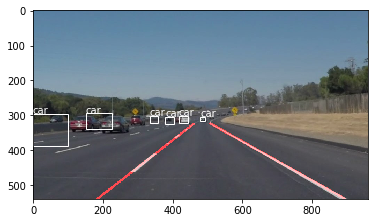

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.66115951538086
car 63.49369287490845
car 85.06513237953186
car 86.3321304321289
car 63.95764350891113
car 63.49036693572998
car 90.2325987815857


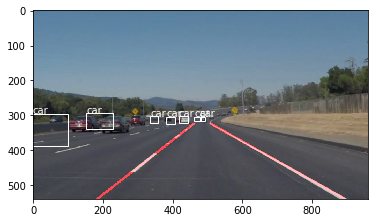

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.5482325553894
car 78.5433292388916
car 74.73410964012146
car 88.73947858810425
car 88.0668044090271


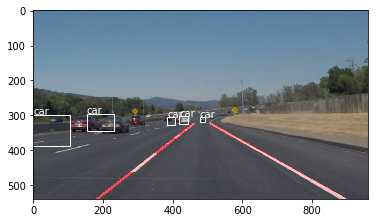

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 88.6312484741211
car 99.35583472251892
car 72.37206101417542
car 69.6119487285614
car 83.15381407737732
car 81.83862566947937


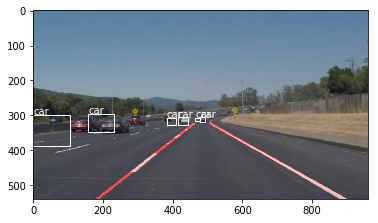

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.55983757972717
car 75.28067231178284
car 60.68764328956604
car 91.78680777549744
car 90.77137112617493
car 83.17452073097229


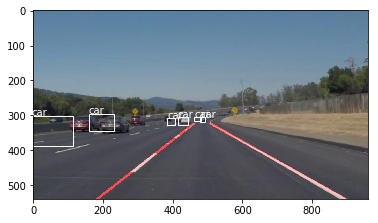

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.64033961296082
car 62.21858263015747
car 80.45578598976135
car 61.1957848072052
car 94.55962777137756
car 88.66411447525024
car 83.98740887641907


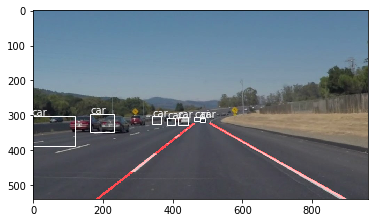

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.66967701911926
car 62.32949495315552
car 65.06949663162231
car 68.65749955177307
car 92.33428239822388
car 77.575021982193
car 81.91160559654236


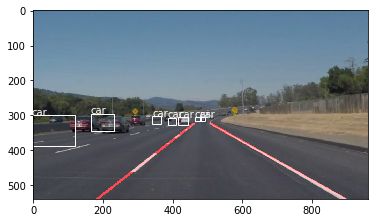

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.68908429145813
car 82.3381245136261
car 64.05621767044067
car 66.82747006416321
car 89.64471817016602
car 80.65447807312012


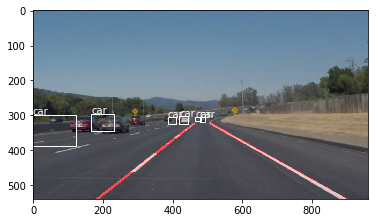

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.65236186981201
car 81.71499371528625
car 68.30621361732483
car 92.51198768615723
car 81.27264976501465


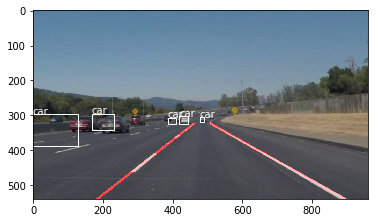

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.67496991157532
car 79.40963506698608
car 60.19245982170105
car 73.67722988128662
car 90.57739973068237
car 79.56621050834656


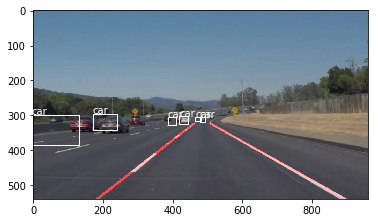

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.65370297431946
car 60.52746772766113
car 66.35215878486633
car 92.7841305732727
car 79.02771830558777
car 78.4646213054657


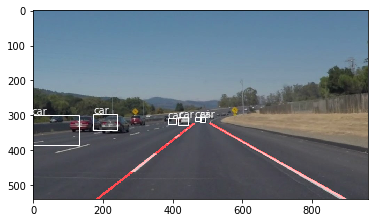

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.83036518096924
car 67.16634631156921
car 65.75403809547424
car 94.48401927947998
car 87.67456412315369
car 83.6876928806305


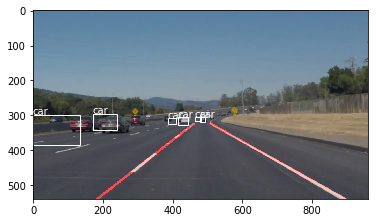

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.79576468467712
car 71.97176218032837
car 67.9278552532196
car 93.13692450523376
car 87.14422583580017
car 85.08359789848328


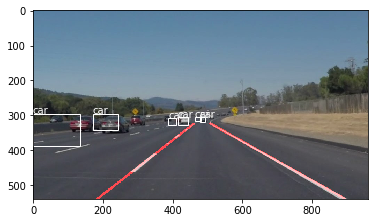

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.81070756912231
car 73.15192222595215
car 63.89284133911133
car 86.62616014480591
car 67.03609824180603
car 90.093332529068
car 85.59801578521729


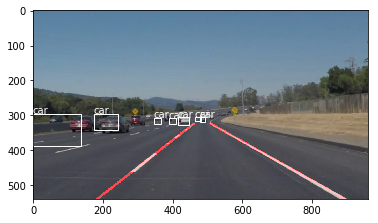

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.7503399848938
car 66.31270051002502
car 74.24331903457642
car 61.30979061126709
car 86.17532253265381
car 62.22931146621704
car 86.69283390045166
car 84.25853252410889


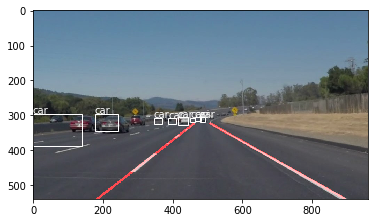

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.86855983734131
car 65.4976487159729
car 75.62769055366516
car 72.96554446220398
car 94.101482629776
car 82.42956399917603
car 77.68998146057129


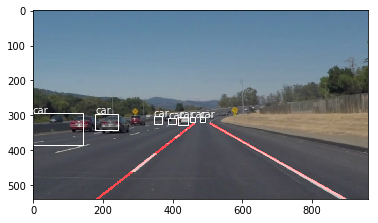

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.89182353019714
car 66.68868064880371
car 81.07130527496338
car 76.69429779052734
car 88.74775767326355
car 81.69957399368286
car 79.52309250831604


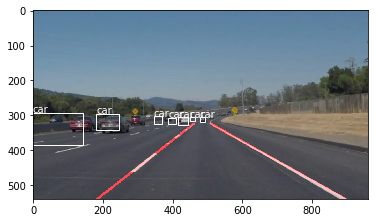

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.87022876739502
car 69.91459727287292
car 78.2230794429779
car 72.89342284202576
car 90.40458798408508
car 83.21954607963562
car 84.72192287445068


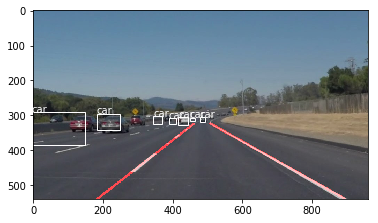

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.87781643867493
car 62.999773025512695
car 74.71065521240234
car 61.40347123146057
car 72.58142232894897
car 92.80665516853333
car 80.87295293807983
car 87.78554201126099


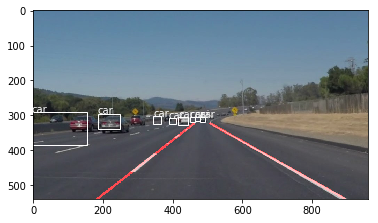

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.87211227416992
car 72.60050773620605
car 75.56140422821045
car 88.02568316459656
car 83.89593362808228
car 88.85934352874756


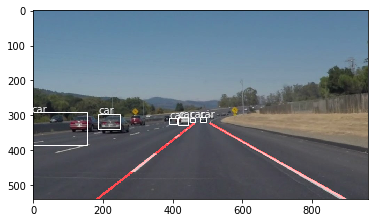

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.93269443511963
car 64.15161490440369
car 91.51861667633057
car 88.05721998214722
car 90.02112150192261


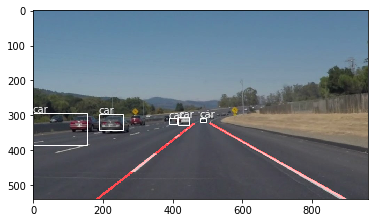

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.91898536682129
car 63.5107159614563
car 67.65298843383789
car 93.40525269508362
car 65.88347554206848
car 84.85928177833557
car 84.51301455497742


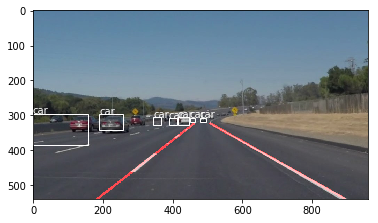

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.93762373924255
car 66.58650636672974
car 67.15109944343567
car 94.73109245300293
car 63.2929265499115
car 88.8156533241272
car 85.96431016921997


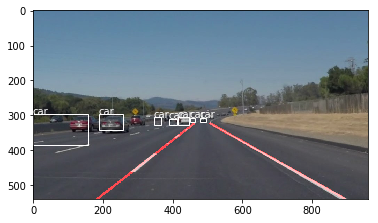

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.93316531181335
car 60.590267181396484
car 67.1984076499939
car 64.08341526985168
car 94.03812289237976
car 88.66043090820312
car 88.42473030090332


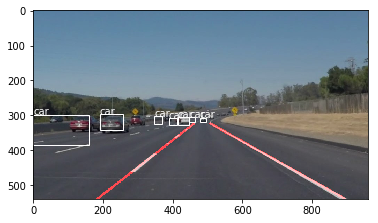

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.94404911994934
car 66.61049127578735
car 64.7707998752594
car 87.4912679195404
car 91.40678644180298
car 89.31534886360168


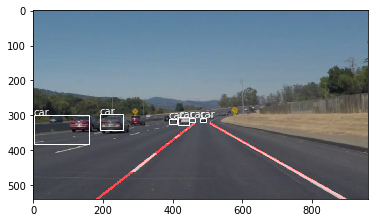

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.919593334198
car 68.72460842132568
car 75.09320378303528
car 82.37636685371399
car 90.40027856826782
car 94.2247211933136


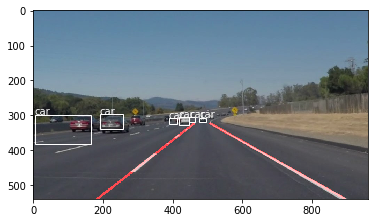

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.93268251419067
car 76.28417015075684
car 83.62499475479126
car 90.44167995452881
car 93.66254806518555
car 73.01188707351685


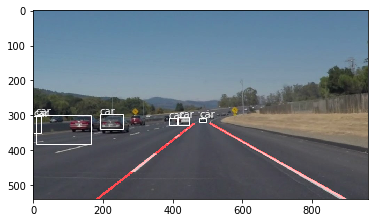

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.93630647659302
car 68.48110556602478
car 77.13052034378052
car 88.58081102371216
car 89.1889214515686
car 93.51293444633484


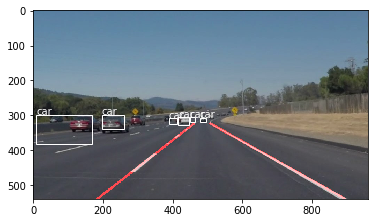

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.94797706604004
car 61.91684007644653
car 70.24374008178711
car 91.96872115135193
car 84.3849241733551
car 92.18525886535645


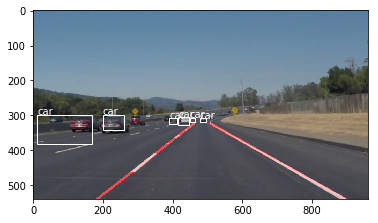

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.94067549705505
car 70.55147290229797
car 75.86531043052673
car 93.72615218162537
car 77.15847492218018
car 90.1029646396637


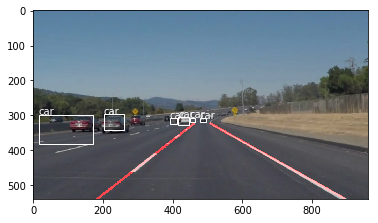

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.92430806159973
car 61.893266439437866
car 62.49654293060303
car 74.17482733726501
car 94.02802586555481
car 86.91720366477966
car 88.83423805236816
car 64.80354070663452


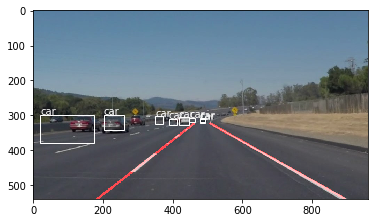

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.85610246658325
car 61.573970317840576
car 63.21788430213928
car 68.73408555984497
car 92.22397804260254
car 84.55710411071777
car 86.1382246017456
car 70.82793712615967


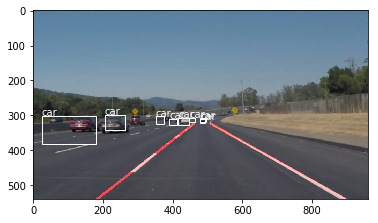

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.7419536113739
car 63.34961652755737
car 69.08010840415955
car 90.91539978981018
car 88.71802687644958
car 88.78053426742554
car 71.22043967247009
car 88.97089958190918


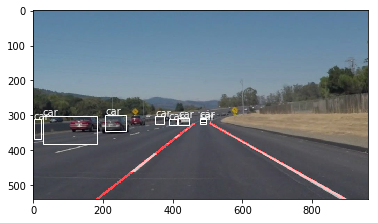

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.8281717300415
car 61.59415245056152
car 73.41693043708801
car 94.31379437446594
car 89.24967050552368
car 89.41899538040161
car 63.7479305267334
car 81.0150682926178


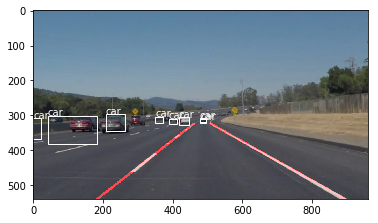

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.84413385391235
car 65.58963656425476
car 69.35449242591858
car 85.44502258300781
car 94.59291100502014
car 87.40633130073547
car 93.46936345100403


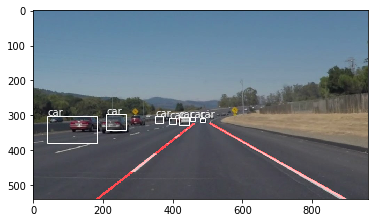

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.87205862998962
car 72.41435050964355
car 82.1061909198761
car 85.83706021308899
car 88.79127502441406
car 89.86951112747192
car 78.43502759933472


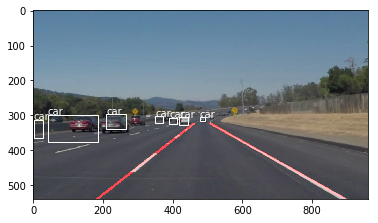

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.88507628440857
car 87.9783570766449
car 93.47277283668518
car 70.62413096427917
car 86.42584681510925
car 90.41349291801453
car 75.06733536720276


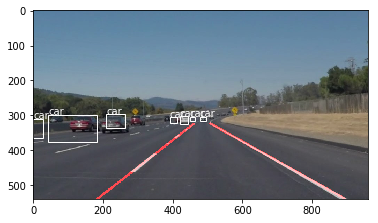

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.89498257637024
car 89.20761942863464
car 93.16869378089905
car 84.53789949417114
car 85.27881503105164
car 77.68948674201965


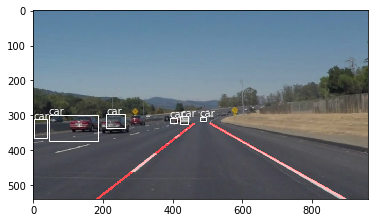

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.91881251335144
car 86.01479530334473
car 93.84734630584717
car 80.3108274936676
car 77.20783352851868
car 93.56425404548645


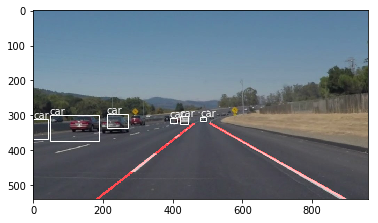

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.91040229797363
car 71.11268043518066
car 84.17432904243469
car 82.75081515312195
car 85.31559705734253
car 89.6507978439331
car 92.10674166679382


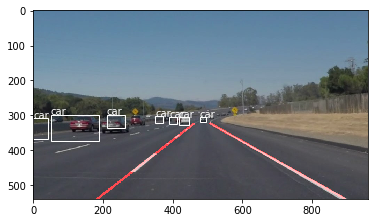

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.76168942451477
car 99.89740252494812
car 64.56307768821716
car 88.88335824012756
car 88.4027361869812
car 86.0657811164856
car 93.81811618804932


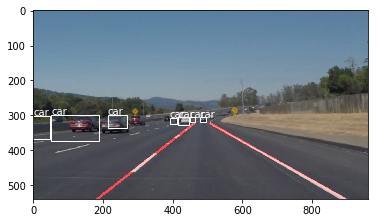

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.32747960090637
car 99.86009001731873
car 65.69433808326721
car 84.66101288795471
car 89.47283625602722
car 76.23111605644226
car 91.57600402832031


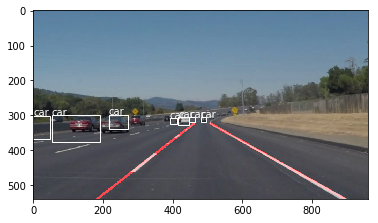

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.0691819190979
car 99.83627796173096
car 64.47998881340027
car 86.55381202697754
car 80.66558837890625
car 81.74389600753784
car 89.56378102302551
car 61.153578758239746


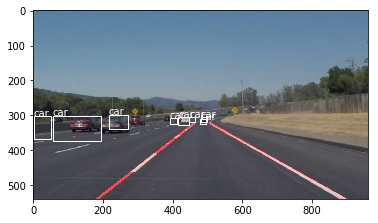

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.20087838172913
car 99.81818795204163
car 64.05617594718933
car 62.64515519142151
car 82.90217518806458
car 79.90843057632446
car 85.1102888584137
car 88.83863687515259
car 75.64032673835754


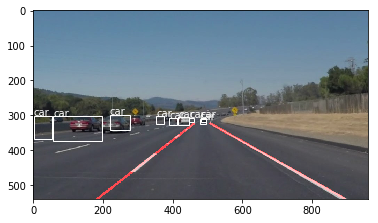

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.94568300247192
car 99.61045384407043
car 61.48185729980469
car 72.7432370185852
car 87.91072964668274
car 80.49343228340149
car 79.54445481300354
car 91.1413848400116


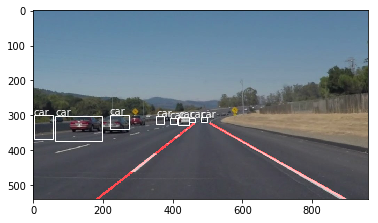

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.26208138465881
car 99.54979419708252
car 61.67554259300232
car 87.6746118068695
car 81.3153088092804
car 78.7669837474823
car 91.82464480400085
car 62.375932931900024


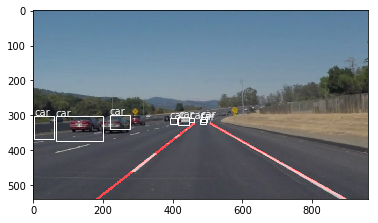

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.73366236686707
car 99.83572959899902
car 65.30987620353699
car 75.06280541419983
car 87.69012689590454
car 75.88478922843933
car 81.78802132606506
car 94.09277439117432


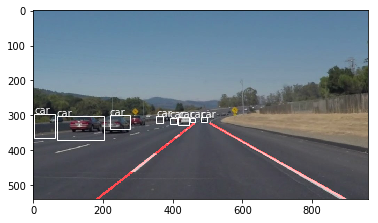

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.269859790802
car 99.73345398902893
car 66.32762551307678
car 89.6718978881836
car 70.97699642181396
car 82.54116177558899
car 92.66436100006104


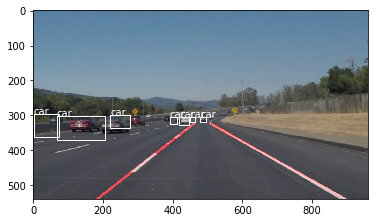

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.84853339195251
car 99.76286292076111
car 65.44666290283203
car 66.69336557388306
car 90.47943353652954
car 69.19036507606506
car 84.02578234672546
car 89.86847400665283


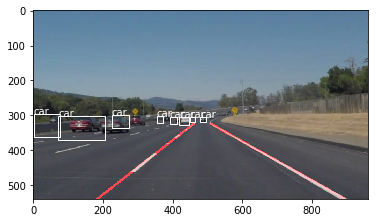

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.42877769470215
car 99.76562261581421
car 77.45417356491089
car 89.21546936035156
car 75.64716339111328
car 81.69366717338562
car 89.38148617744446


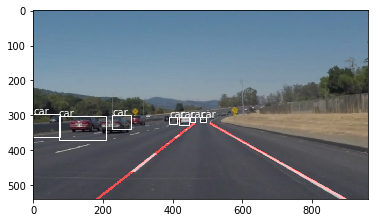

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.46319651603699
car 99.81109499931335
car 77.76139974594116
car 88.01267147064209
car 83.4036111831665
car 78.61014604568481
car 90.5860185623169


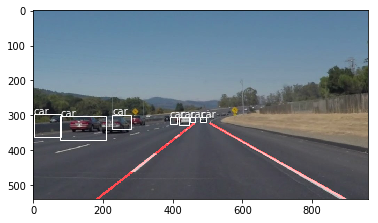

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.6060996055603
car 99.70243573188782
car 80.86867928504944
car 65.34944176673889
car 87.07178235054016
car 72.52442240715027
car 83.28796029090881
car 93.77626180648804


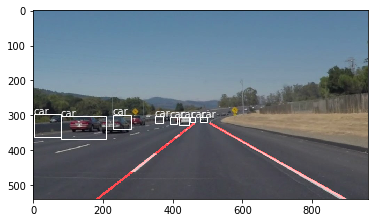

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.24153280258179
car 99.77458119392395
car 76.04737877845764
car 67.3693060874939
car 83.7796151638031
car 68.99197101593018
car 82.71875381469727
car 93.28455924987793


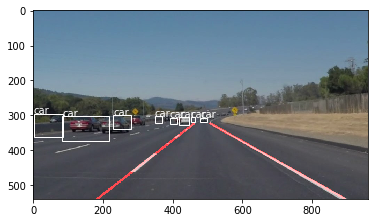

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.5353786945343
car 99.82521533966064
car 74.4242250919342
car 67.91475415229797
car 81.42460584640503
car 72.94071912765503
car 74.74494576454163
car 91.81913137435913


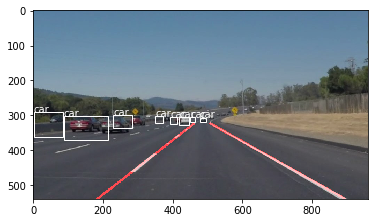

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.230055809021
car 99.6225118637085
car 76.18858218193054
car 90.31851291656494
car 65.02196192741394
car 87.7733051776886
car 72.08032608032227
car 77.04857587814331


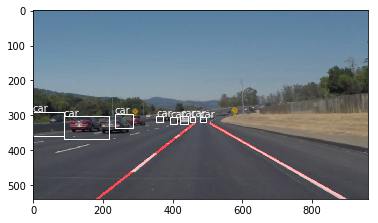

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 88.04730772972107
car 99.41411018371582
car 73.83884191513062
car 91.90794825553894
car 62.938326597213745
car 86.84321641921997
car 76.62414908409119
car 74.7553825378418


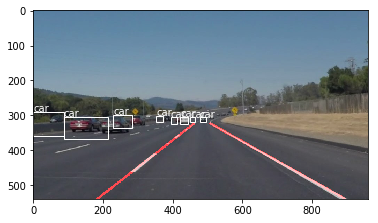

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.25927186012268
car 99.43535923957825
car 73.06385040283203
car 81.49099946022034
car 93.94205212593079
car 89.16137218475342
car 70.21375298500061
car 74.63491559028625


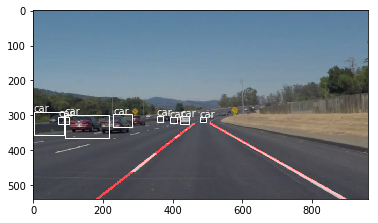

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 88.5882556438446
car 99.6030867099762
car 78.57663631439209
car 74.28334355354309
car 94.5480227470398
car 91.59464240074158
car 84.72633957862854


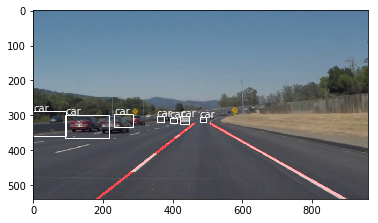

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.00410056114197
car 99.36463236808777
car 76.06562376022339
car 93.56685876846313
car 89.23280239105225
car 83.78514051437378
car 67.69976615905762


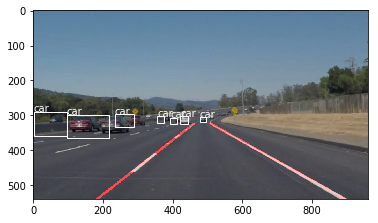

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.7528669834137
car 99.0831196308136
car 70.87868452072144
car 95.7484245300293
car 62.84925937652588
car 89.08644318580627
car 79.69845533370972
car 68.79794001579285


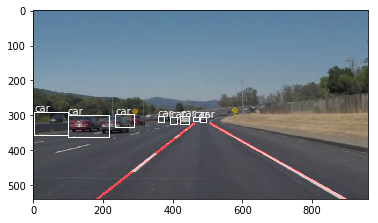

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.76049542427063
car 98.65139722824097
car 79.98168468475342
car 93.2183027267456
car 70.72954773902893
car 88.80318999290466
car 74.5825707912445
car 69.83189582824707


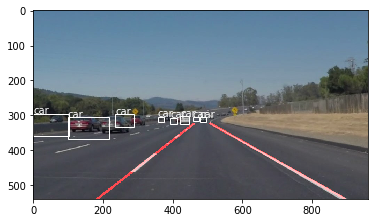

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.92468023300171
car 99.11229610443115
car 76.4586865901947
car 89.32549953460693
car 72.46614098548889
car 86.58387064933777
car 77.71162986755371
car 69.92262005805969


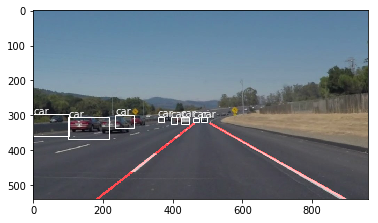

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.86776971817017
car 99.44303631782532
car 73.31137657165527
car 80.8587372303009
car 82.85931348800659
car 71.70243263244629
car 93.31506490707397


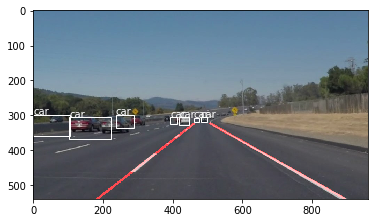

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 85.1719081401825
car 99.40673112869263
car 77.85974144935608
car 77.74271368980408
car 82.41981267929077
car 72.00537919998169
car 90.58719873428345


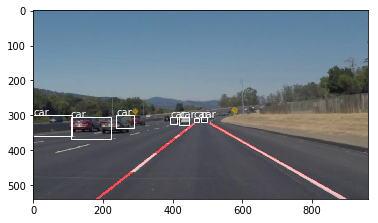

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.65886759757996
car 99.6179461479187
car 74.2913007736206
car 69.09273266792297
car 86.52513027191162
car 91.20267033576965


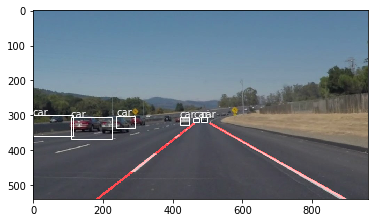

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.42149591445923
car 99.4748055934906
car 71.17148637771606
car 73.61307144165039
car 83.96520614624023
car 92.52174496650696


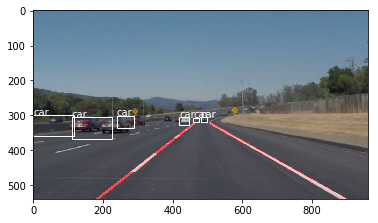

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.7201886177063
car 99.58930015563965
car 62.96455264091492
car 86.53605580329895
car 67.64927506446838
car 92.89582371711731
car 72.47955799102783


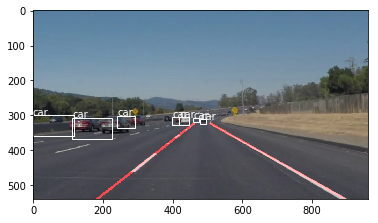

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.44552540779114
car 99.2357611656189
car 62.10041046142578
car 79.29325103759766
car 73.25628399848938
car 91.58686995506287
car 78.22280526161194


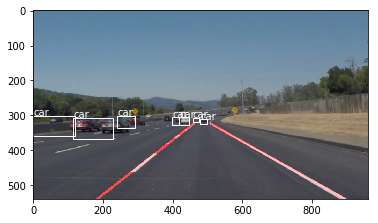

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 86.73863410949707
car 99.05378222465515
car 61.744534969329834
car 67.48480200767517
car 79.56879734992981
car 61.30920648574829
car 89.30354714393616
car 83.4155023097992


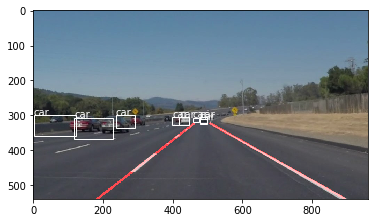

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.04449248313904
car 98.87855052947998
car 62.129878997802734
car 81.37567043304443
car 92.7325189113617
car 78.47248315811157


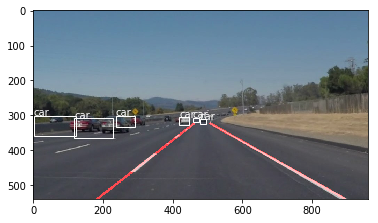

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.87212204933167
car 99.61816072463989
car 70.54911255836487
car 63.00817131996155
car 69.14947628974915
car 79.96144890785217
car 93.18053722381592
car 81.44959807395935


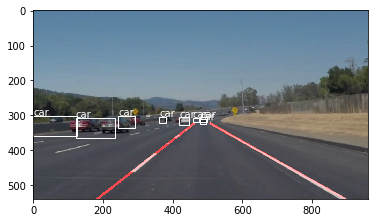

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.01347255706787
car 98.92688989639282
car 70.8496630191803
car 69.09383535385132
car 75.0119149684906
car 78.38950753211975
car 62.97435760498047
car 94.81785893440247
car 81.39902949333191


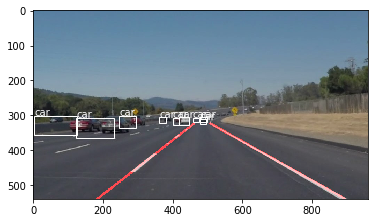

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.20534563064575
car 98.80235195159912
car 78.303462266922
car 68.56501698493958
car 71.56027555465698
car 61.41616702079773
car 95.88221907615662
car 70.16234993934631


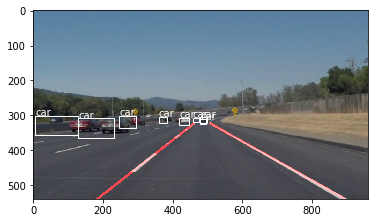

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.37927103042603
car 98.66169691085815
car 87.77436017990112
car 82.67260193824768
car 73.68730902671814
car 77.73329019546509
car 60.45820713043213
car 95.25967836380005
car 76.498943567276


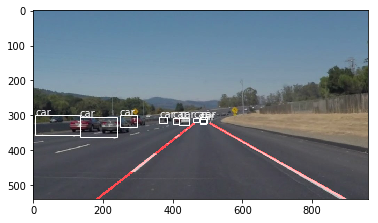

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.87145042419434
car 99.57122206687927
car 86.88808679580688
car 78.12193036079407
car 72.14542627334595
car 85.75223088264465
car 93.70015859603882
car 74.28502440452576


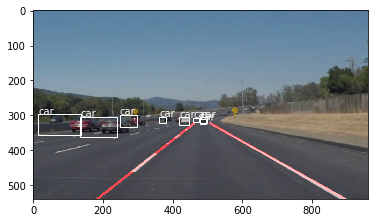

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.65474677085876
car 99.46795701980591
car 89.34677839279175
car 81.09104633331299
car 69.2834734916687
car 79.5717716217041
car 70.98696827888489
car 95.35874724388123
car 78.9328396320343


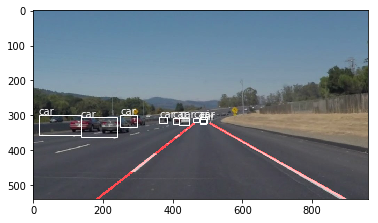

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.23072552680969
car 99.6376097202301
car 90.04619717597961
car 82.97945857048035
car 77.22001671791077
car 88.53144645690918
car 71.40937447547913
car 95.47868371009827
car 79.4464647769928


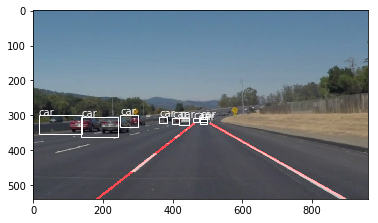

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.96326661109924
car 99.51412677764893
car 89.26310539245605
car 78.35940718650818
car 74.37876462936401
car 89.90769982337952
car 75.50639510154724
car 95.61538696289062
car 78.14632654190063


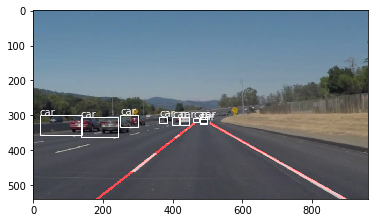

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.49648976325989
car 99.56989288330078
car 88.29187154769897
car 83.17146897315979
car 79.07191514968872
car 85.08145809173584
car 74.16126728057861
car 96.49431109428406


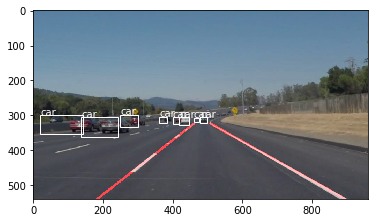

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.56179451942444
car 98.75112771987915
car 82.27072954177856
car 85.40840148925781
car 80.40845394134521
car 83.16472172737122
car 72.41196632385254
car 95.31332850456238


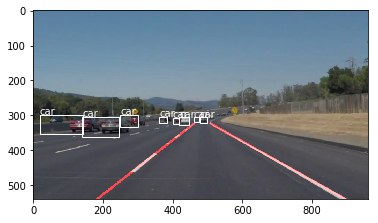

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.42534756660461
car 98.3300268650055
car 91.4706826210022
car 80.1357090473175
car 78.97698283195496
car 77.76922583580017
car 87.75280117988586
car 64.9637520313263
car 94.7533667087555


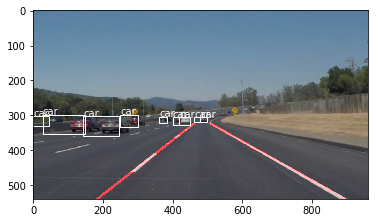

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.06545567512512
car 98.9470362663269
car 90.13838768005371
car 83.80626440048218
car 78.87000441551208
car 89.7998571395874
car 71.23274803161621
car 95.72863578796387


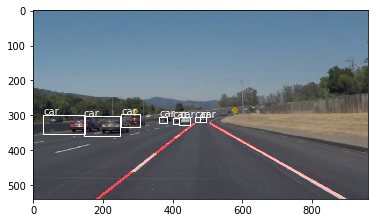

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.85319447517395
car 99.08292293548584
car 92.53823161125183
car 83.506840467453
car 77.72672772407532
car 85.31716465950012
car 71.25895023345947
car 95.24317383766174


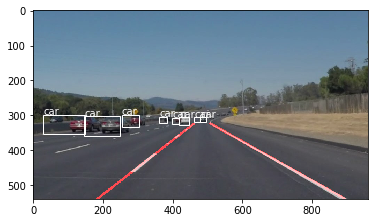

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.54140448570251
car 95.45059204101562
car 93.35666298866272
car 84.7612977027893
car 79.27648425102234
car 83.20457935333252
car 74.7679054737091
car 95.74252367019653


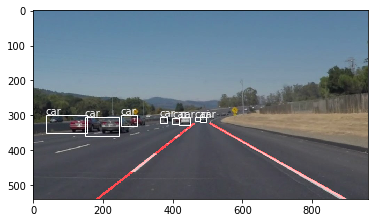

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.51391911506653
car 99.42620396614075
car 91.41908884048462
car 84.91418361663818
car 79.17872667312622
car 89.17990326881409
car 77.77458429336548
car 95.54533958435059


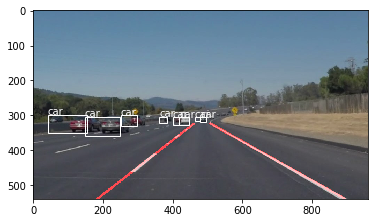

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.23452234268188
car 99.09545183181763
car 90.7205879688263
car 83.82877707481384
car 82.38187432289124
car 85.750812292099
car 76.05666518211365
car 95.22629380226135


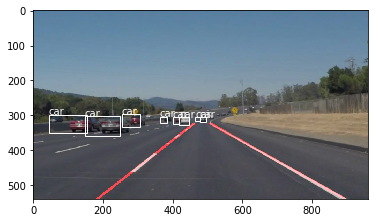

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.86898589134216
car 99.02969598770142
car 83.68080854415894
car 92.57702827453613
car 82.95609951019287
car 72.8131651878357
car 73.30474257469177
car 93.36467385292053


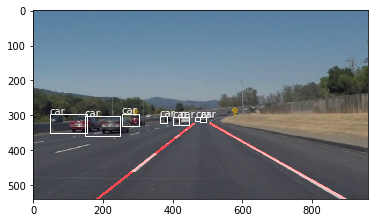

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.83750367164612
car 98.95879626274109
car 95.22044658660889
car 81.43675327301025
car 72.31394648551941
car 87.33513951301575
car 70.85968255996704
car 94.99338865280151


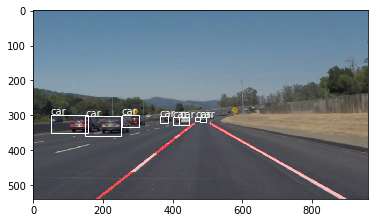

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.91679573059082
car 98.45607280731201
car 90.9607470035553
car 91.7839765548706
car 82.39524960517883
car 73.17086458206177
car 90.4974639415741


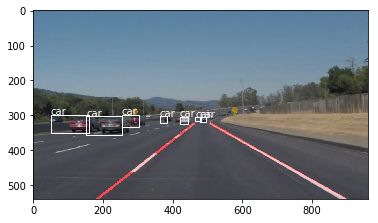

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.33943343162537
car 98.87514114379883
car 91.32394790649414
car 72.5931465625763
car 84.22781825065613
car 94.95148062705994
car 75.327467918396
car 83.05467963218689


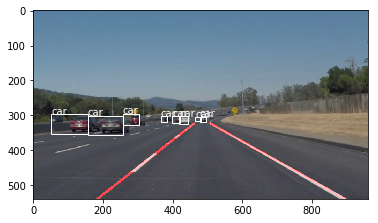

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 79.32889461517334
car 97.58250117301941
car 89.1092598438263
car 74.23183917999268
car 83.84040594100952
car 98.1026828289032
car 85.19296050071716


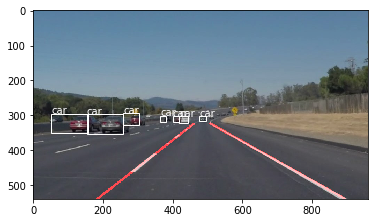

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.81527614593506
car 98.72238039970398
car 68.53304505348206
car 86.89227104187012
car 74.76465106010437
car 82.51650333404541
car 96.94784879684448
car 66.31712317466736
car 85.76875329017639


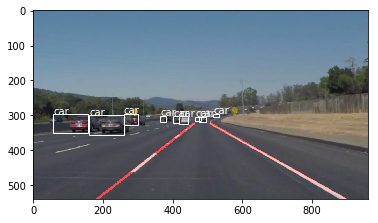

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.37146091461182
car 99.02909398078918
car 81.76813125610352
car 92.60825514793396
car 72.22595810890198
car 76.66429281234741
car 86.01504564285278


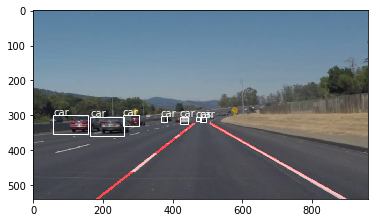

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.92406558990479
car 98.23029041290283
car 79.7294020652771
car 65.32011032104492
car 84.07653570175171
car 77.83628702163696
car 72.18093276023865
car 96.14514708518982
car 64.89561796188354


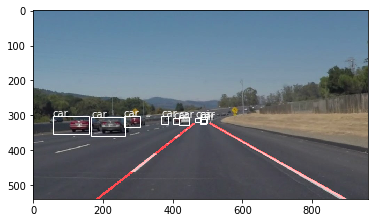

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.47765564918518
car 98.57608675956726
car 81.87888860702515
car 82.56255388259888
car 79.18674945831299
car 69.12914514541626
car 96.66796922683716


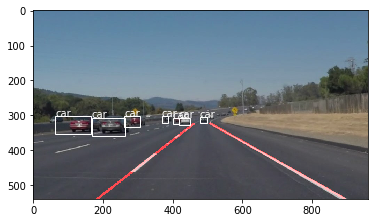

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.11745572090149
car 98.79167675971985
car 86.42141222953796
car 84.66224074363708
car 76.97837352752686
car 96.83478474617004
car 75.9877622127533


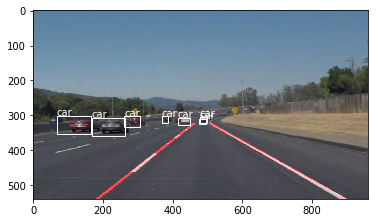

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.24849557876587
car 98.38181734085083
car 91.91330671310425
car 84.49766635894775
car 66.26115441322327
car 97.48819470405579
car 85.89115738868713


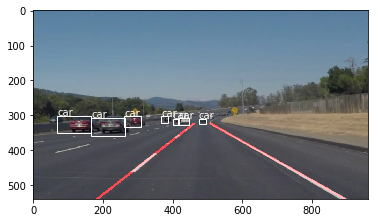

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.85556197166443
car 98.65414500236511
car 87.29349970817566
car 83.46757292747498
car 81.62612915039062
car 67.86453127861023
car 94.76986527442932
car 75.16676783561707


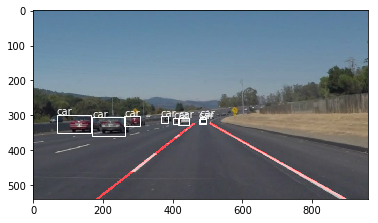

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.47269654273987
car 98.30158352851868
car 94.28568482398987
car 83.21056365966797
car 88.10877203941345
car 75.15255808830261
car 95.79337239265442
car 82.50229358673096


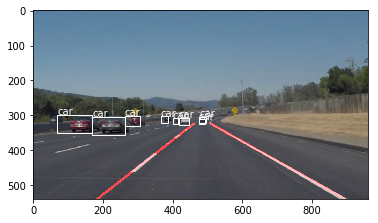

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.11386561393738
car 98.33903312683105
car 93.79982948303223
car 89.86891508102417
car 91.61369800567627
car 67.88225173950195
car 96.78618311882019
car 70.16748189926147


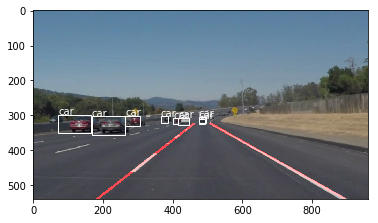

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.41757607460022
car 92.81136989593506
car 87.95546293258667
car 89.5427405834198
car 76.44035220146179
car 96.32697105407715
car 78.98828387260437
car 97.67841100692749


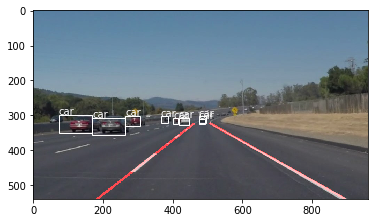

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.51769590377808
car 97.7622389793396
car 90.61641097068787
car 87.33320236206055
car 74.10137057304382
car 94.36730146408081
car 63.931792974472046
car 96.72744274139404
car 69.98671889305115


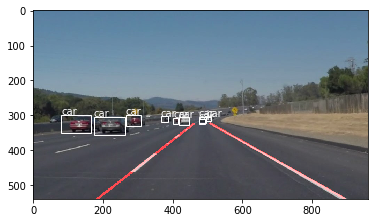

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.4531798362732
car 85.9499454498291
car 86.87704801559448
car 75.05512237548828
car 92.30101108551025
car 95.3840970993042
car 96.66704535484314


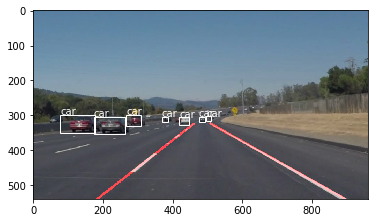

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.31249785423279
car 92.55971312522888
car 85.4362964630127
car 74.38862323760986
car 89.21839594841003
car 96.55349254608154
car 97.10389971733093


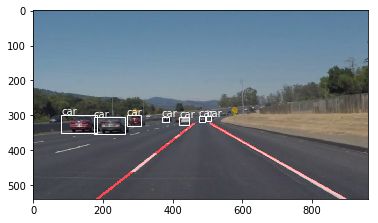

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 82.86383152008057
car 91.68314337730408
car 90.79517722129822
car 66.03276133537292
car 86.23292446136475
car 94.35471296310425
car 95.91017365455627


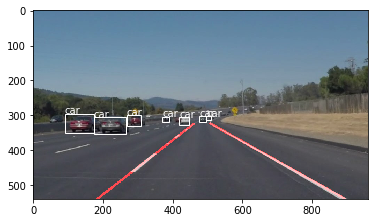

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.35402250289917
car 83.69181752204895
car 96.43356800079346
car 89.61979150772095
car 85.0675642490387
car 95.23316025733948


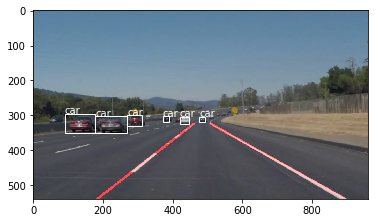

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.8268473148346
car 86.64101362228394
car 67.53593683242798
car 95.9514856338501
car 89.02069330215454
car 61.15078330039978
car 88.01406025886536
car 97.30489253997803


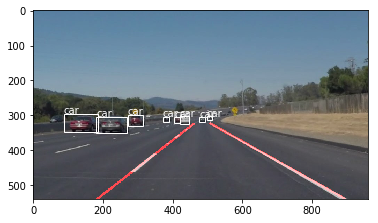

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.36150598526001
car 82.86954760551453
car 89.9540662765503
car 76.60976052284241
car 97.50460386276245
car 88.30190896987915
car 93.93271207809448


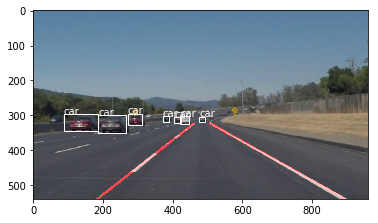

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.38788604736328
car 96.63517475128174
car 81.82605504989624
car 90.16087651252747
car 77.04490423202515
car 98.1243371963501
car 92.7352249622345


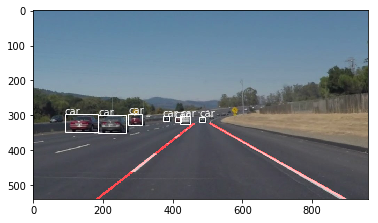

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.4359838962555
car 88.04377317428589
car 88.6993408203125
car 69.61536407470703
car 97.89762496948242
car 92.03608632087708
car 98.10732007026672


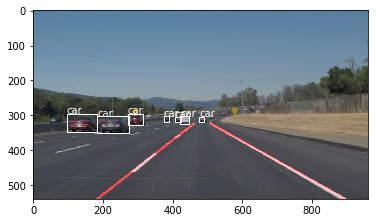

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.7740831375122
car 76.66991949081421
car 94.75361108779907
car 93.88754367828369
car 60.55986285209656
car 90.32506346702576
car 89.67108726501465
car 99.09411668777466


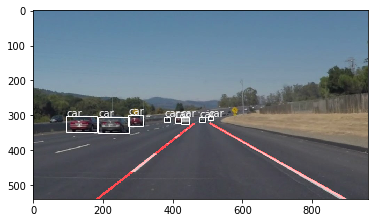

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.63604974746704
car 93.59889030456543
car 90.3097927570343
car 75.03510117530823
car 88.13152313232422
car 95.35849094390869
car 71.68571352958679
car 99.36182498931885


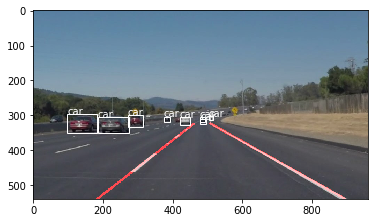

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.64843368530273
car 95.4158067703247
car 90.10699987411499
car 79.83076572418213
car 91.58236980438232
car 96.4676558971405
car 80.6632399559021
car 99.31533932685852


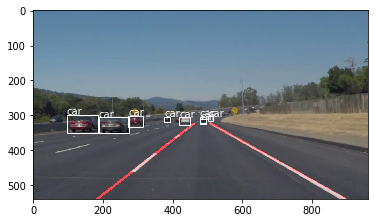

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.43371200561523
car 92.58475303649902
car 79.9456000328064
car 90.1104211807251
car 96.40891551971436
car 86.99711561203003
car 96.2633728981018
car 98.97834658622742


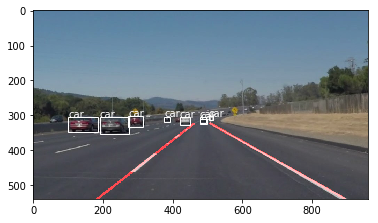

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.71194744110107
car 86.95957660675049
car 79.29927706718445
car 87.48646974563599
car 68.04723739624023
car 96.54995203018188
car 90.23849368095398
car 95.26350498199463
car 98.69773387908936


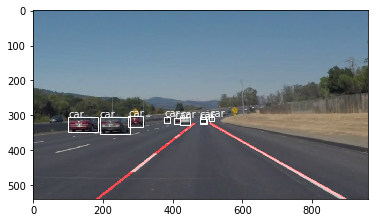

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 80.00227808952332
car 93.71493458747864
car 87.85821199417114
car 86.96680665016174
car 74.64476227760315
car 65.26805758476257
car 95.76101899147034
car 93.60558986663818
car 95.17281651496887
car 97.38718271255493


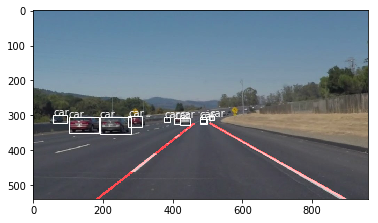

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.74487328529358
car 91.34529232978821
car 90.81835746765137
car 76.84071660041809
car 88.4645164012909
car 97.14281558990479
car 87.01996207237244
car 95.71095108985901
car 99.05779361724854


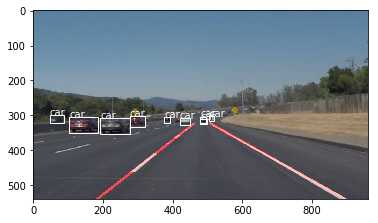

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 65.83369970321655
car 75.21368265151978
car 91.5525734424591
car 92.1229600906372
car 80.85521459579468
car 85.70849895477295
car 96.14909291267395
car 83.29877853393555
car 95.52881717681885
car 99.11459684371948


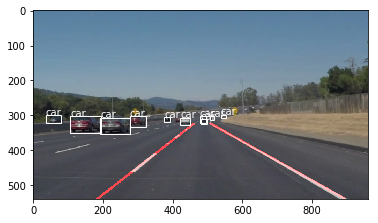

<class 'numpy.ndarray'>
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 72.7230429649353
car 88.65799307823181
car 92.34731197357178
car 67.83515214920044
car 85.49812436103821
car 94.84105110168457
car 93.77506375312805
car 99.12309050559998


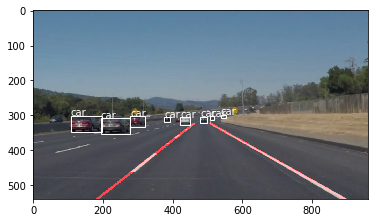

<class 'NoneType'>
Sun Aug 25 16:56:17 2019


In [7]:
import time
print (time.asctime( time.localtime(time.time()) ))
cap = cv2.VideoCapture('/kaggle/input/videos/solidWhiteRight.mp4')
# Define the codec and create VideoWriter object.The output is stored in 'outpy.avi' file.
out = cv2.VideoWriter('outpy.avi',cv2.VideoWriter_fourcc(*'MJPG'),30.0, (640,480))
while(cap.isOpened()):
    ret,frame = cap.read()
    print(type(frame))
    cv2.imwrite('1.jpg',frame)
    if ret==True:
        a=compute('1.jpg',img,pipeline)
        out.write(a)
    else:
        break
cap.release()
print (time.asctime( time.localtime(time.time()) ))

In [8]:
from IPython.display import HTML
def create_download_link(filename):  
    title = "Download video file"
    html = '<a href={filename}>{title}</a>'
    html = html.format(title=title,filename=filename)
    return HTML(html)
create_download_link('outpy.avi')